# Vehicle Pricing Model

**Team Members**: Devanshi Kothari, Aashika Vishwanath, Neha Krishna

**Overview**: This final project utilizes the Vehicle Sales dataset from Kaggle. Our goal through this project is to explore trends of vehicle sales over time, analyze relationships between different variables in the dataset, and ultimately build a predictive model to accurately estimate vehicle selling prices given several features. We accomplished this by pre-processing the data and then building the model upon our cleaned data. Specifically, the sections included within this annotated notebook cover:

*   Loading in Data
*   Data Cleaning
*   Exploratory Data Analysis (Statistics & Distributions)
*   Feature Engineering
*   Feature Encoding
*   Outliers, Imbalances, Correlations
*   Scaling Data
*   Model Building and Analysis

**Problem Statement**: There are many factors that contribute to the selling price of a vehicle, including characteristics such as the vehicle's make, model, trim, color, etc. Given a car, with several diverse features, how does one estimate it's potential selling price? In the second-hand car market, many owners looking to resell their vehicle may be wondering the same. This project aims to address this issue.

**Objective and Value Proposition**: The objective of this project is to predict the appropriate selling price for a vehicle given several of its features. This is especially valuable for organizations, industry experts, and car owners as they can dervive insights into the estimated selling prices of different vehicles and the most significant features that contribute to the selling price of a vehicle, enabling them to develop appropriate pricing strategies and dive deeper into consumer preferences and market demand.

**Dataset Overview**: As mentioned above, this project utilizes [Kaggle's Vehicle Sales dataset](https://www.kaggle.com/datasets/syedanwarafridi/vehicle-sales-data
) which has an size of 558,838 values. The dataset initially contains the following columns, which we've separated into our features and target variable:

*   Features: `year`, `make`, `model`, `trim`, `body`, `transmission`, `vin`, `state`, `condition`, `odometer`, `color`, `interior`, `seller`, `mmr`, `saledate`
*   Target Variable: `sellingprice`

We use these features, along with other engineered features (will be discussed later on in the notebook), to analyze and build our models.
Some highlights of the data cleaning process include: removing/imputing missing values, dealing with sections of our dataset that were internally shifted by a column, cleaning string data, adjusting data types, etc.

**EDA Highlights**: Some highlights from Exploratory Data Analysis include, but are not limited to:

*   The vehicle sales were over the time period of 2014-2015.
*   Some categories, such as trim, have very many unique values.
*   Some features display high levels of correlation.

We utilized the following libraries to assist us with plotting distributions: matplotlib, seaborn, and plotly.


# Notebook Setup
The following cells help us to set up the notebook.

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Load Data + Initial Explanations

In [ ]:
df = pd.read_csv('/content/drive/My Drive/CIS 545 Final Project/car_prices.csv')

In [ ]:
# Information about columns, data types, and non-null counts
# to ensure the dataset is viable

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 558837 entries, 0 to 558836
Data columns (total 16 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   year          558837 non-null  int64  
 1   make          548536 non-null  object 
 2   model         548438 non-null  object 
 3   trim          548186 non-null  object 
 4   body          545642 non-null  object 
 5   transmission  493485 non-null  object 
 6   vin           558833 non-null  object 
 7   state         558837 non-null  object 
 8   condition     547017 non-null  float64
 9   odometer      558743 non-null  float64
 10  color         558088 non-null  object 
 11  interior      558088 non-null  object 
 12  seller        558837 non-null  object 
 13  mmr           558799 non-null  float64
 14  sellingprice  558825 non-null  float64
 15  saledate      558825 non-null  object 
dtypes: float64(4), int64(1), object(11)
memory usage: 68.2+ MB


**Observations from above**: After running `df.info()`, we see that there are a good number of missing values. There are 558,837 total entries, yet many of the columns have fewer non-null entries. This shows that we will need to identify and deal with missing values in the data cleaning stage.

Now, we can visualize a section of the dataset via `df.head()` and get descriptive stats of numerical columns via `df.describe()`

In [ ]:
df.head()

,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate
0,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg566472,ca,5.0,16639.0,white,black,kia motors america inc,20500.0,21500.0,Tue Dec 16 2014 12:30:00 GMT-0800 (PST)
1,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg561319,ca,5.0,9393.0,white,beige,kia motors america inc,20800.0,21500.0,Tue Dec 16 2014 12:30:00 GMT-0800 (PST)
2,2014,BMW,3 Series,328i SULEV,Sedan,automatic,wba3c1c51ek116351,ca,45.0,1331.0,gray,black,financial services remarketing (lease),31900.0,30000.0,Thu Jan 15 2015 04:30:00 GMT-0800 (PST)
3,2015,Volvo,S60,T5,Sedan,automatic,yv1612tb4f1310987,ca,41.0,14282.0,white,black,volvo na rep/world omni,27500.0,27750.0,Thu Jan 29 2015 04:30:00 GMT-0800 (PST)
4,2014,BMW,6 Series Gran Coupe,650i,Sedan,automatic,wba6b2c57ed129731,ca,43.0,2641.0,gray,black,financial services remarketing (lease),66000.0,67000.0,Thu Dec 18 2014 12:30:00 GMT-0800 (PST)


In [ ]:
df.describe()

,year,condition,odometer,mmr,sellingprice
count,558837.000000,547017.000000,558743.000000,558799.000000,558825.000000
mean,2010.038927,30.672365,68320.017767,13769.377495,13611.358810
std,3.966864,13.402832,53398.542821,9679.967174,9749.501628
min,1982.000000,1.000000,1.000000,25.000000,1.000000
25%,2007.000000,23.000000,28371.000000,7100.000000,6900.000000
50%,2012.000000,35.000000,52254.000000,12250.000000,12100.000000
75%,2013.000000,42.000000,99109.000000,18300.000000,18200.000000
max,2015.000000,49.000000,999999.000000,182000.000000,230000.000000


**Observations from above**:

* The median `condition` score is higher than the mean, which suggests a skew towards higher `condition` values.
* `mmr` values have mean of around `$13,769`, while `sellingprice` has mean close to the `mmr` at about `$13,611`. This implies that `mmr` might be data leak.

**Definitions of Critical Variables**:

* `year`: Manufacturing year of the car
* `make`: Company that manufactures the car
* `model`: The car's "name" within the manufacturer
* `trim`: Refers to a pre-packaged group of features for a car (can be different within a model)
* `body`: The outer structure of the vehicle (i.e. sedan, SUV, etc)
* `transmission`: Medium that transmits power generated by engine to the wheels (2 types - automatic + manual)
* `vin`: unique identifier for a car
* `state`: Geographical state the vehicle is purchased in
* `condition`: the state of the car when it is purchased
* `odometer`: distance a vehicle has traveled when purchased
* `color`: exterior color of the car
* `interior`: interior color of car
* `seller`: company that sold the car
* `mmr`: Manheim Market Report which is the market indicator for wholesale price of the car
* `sellingprice`: price the car was sold at
* `saledate`: date the car was sold

# Data Cleaning
This section goes over data cleaning for the entire dataset.

First, we start by checking the number and distribution of missing values for each column.

In [ ]:
missing_values = df.isnull().sum()
missing = missing_values[missing_values > 0].sort_values(ascending=False)
missing

transmission    65352
body            13195
condition       11820
trim            10651
model           10399
make            10301
color             749
interior          749
odometer           94
mmr                38
sellingprice       12
saledate           12
vin                 4
dtype: int64

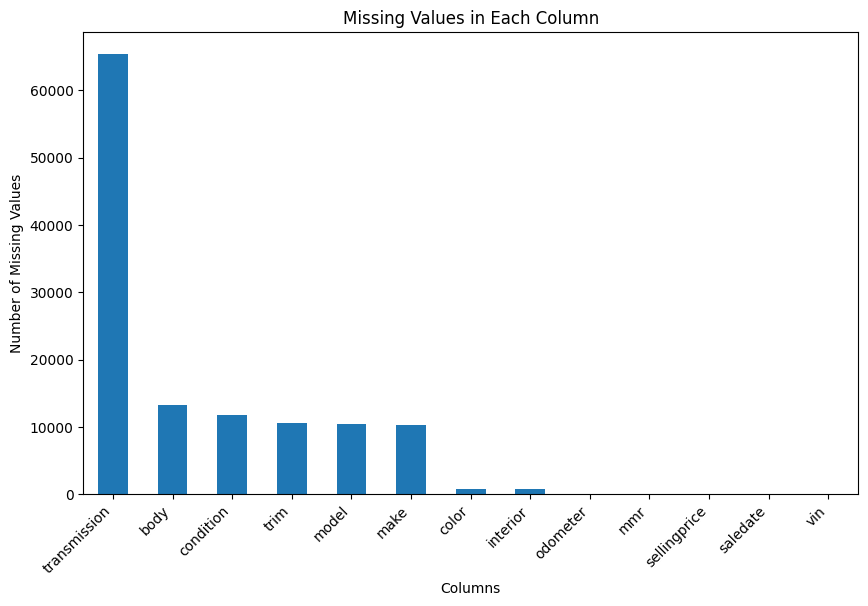

In [ ]:
plt.figure(figsize=(10, 6))
missing.plot(kind='bar')
plt.title('Missing Values in Each Column')
plt.xlabel('Columns')
plt.ylabel('Number of Missing Values')
plt.xticks(rotation=45, ha="right")
plt.show()

**Observations from above**:


*   We see that the `transmission`, `body`, `condition`, `trim`, `model`, `make`, `color`, `interior`, `odometer`, `mmr`, `sellingprice`, `saledate`, and `vin` columns are missing values.
*   `transmission` has the most missing values while `body`, `condition`, `trim`, `model`, and `make` have a similar number of missing values. `color` and `interior` also have the same number of missing values, which makes sense as one column describes the exterior color and the other column describes the interior color of the car.
* 11.7% of the entries are missing `transmission` data (65352 / 558837 = 0.1169)




## Transmission Column - Shifted & Missing Values
Now, we can investigate the `transmission` column due to it having the greatest number of missing values.

In [ ]:
df['transmission'].value_counts()

# sedan is not a transmission type (need to further investigate)

transmission
automatic    475915
manual        17544
sedan            15
Sedan            11
Name: count, dtype: int64

Below is a plot for the two `transmission` types relative to `sellingprice`. This is to see if `transmission` is an indicative variable for the target variable (`sellingprice`).


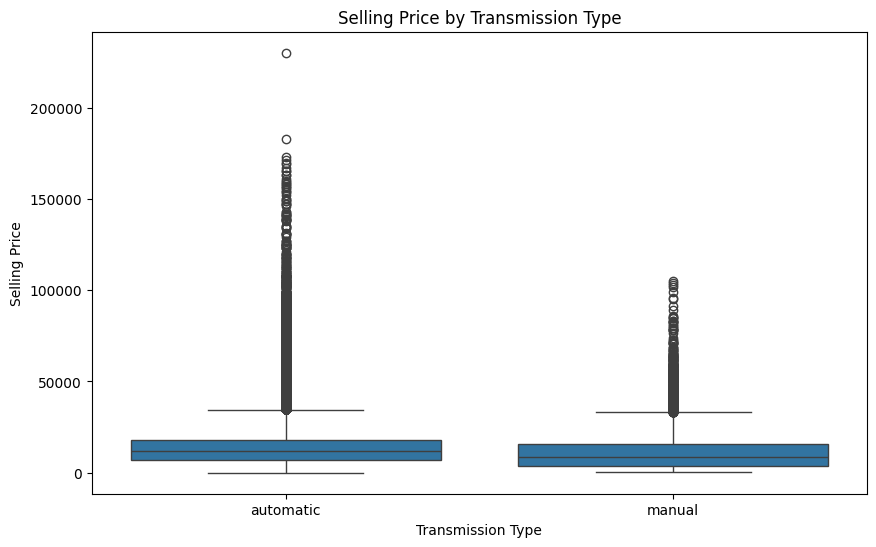

In [ ]:
corrected_transmissions = df[df['transmission'].isin(['automatic', 'manual'])]

plt.figure(figsize=(10, 6))
sns.boxplot(x='transmission', y='sellingprice', data=corrected_transmissions)
plt.title('Selling Price by Transmission Type')
plt.xlabel('Transmission Type')
plt.ylabel('Selling Price')
plt.show()

**Observations from above**: Transmission type doesn't seem to be too predictive of selling price as there are no stark differences in selling price among automatic vs. manual transmission types.

In [ ]:
trans = df.groupby('transmission')['sellingprice'].mean()
trans

transmission
Sedan        13686.363636
automatic    13540.406866
manual       11211.448358
sedan        13650.000000
Name: sellingprice, dtype: float64

There is a clear difference in the mean prices between manual and automatic cars which indicates that we should keep this variable.

The following cells are investigating why there are `body` types in this column (Sedan and sedan)

In [ ]:
sedan = df[(df['transmission'] == 'Sedan') | (df['transmission'] == 'sedan')]
sedan

,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate
408161,2015,Volkswagen,Jetta,SE PZEV w/Connectivity,Navitgation,Sedan,automatic,3vwd17aj4fm201708,NaN,46.0,4802,silver,gray,NaN,13200.0,16500
417835,2015,Volkswagen,Jetta,SE PZEV w/Connectivity,Navitgation,Sedan,automatic,3vwd17aj2fm258506,NaN,1.0,9410,white,gray,NaN,13300.0,10500
421289,2015,Volkswagen,Jetta,SE PZEV w/Connectivity,Navitgation,Sedan,automatic,3vwd17aj3fm276741,NaN,46.0,1167,blue,black,NaN,13200.0,12700
424161,2015,Volkswagen,Jetta,SE PZEV w/Connectivity,Navitgation,Sedan,automatic,3vwd17aj2fm285365,NaN,1.0,2172,gray,black,NaN,14050.0,8250
427040,2015,Volkswagen,Jetta,SE PZEV w/Connectivity,Navitgation,Sedan,automatic,3vwd17aj0fm227318,NaN,41.0,14872,gray,black,NaN,13700.0,14300
427043,2015,Volkswagen,Jetta,SE PZEV w/Connectivity,Navitgation,Sedan,automatic,3vwd17aj6fm218641,NaN,49.0,12655,red,black,NaN,13850.0,14500
434424,2015,Volkswagen,Jetta,SE PZEV w/Connectivity,Navitgation,Sedan,automatic,3vwd17aj7fm223475,NaN,46.0,15719,blue,black,NaN,13650.0,13500
444501,2015,Volkswagen,Jetta,SE PZEV w/Connectivity,Navitgation,Sedan,automatic,3vwd17aj5fm297123,NaN,2.0,6388,white,black,NaN,13850.0,10700
453794,2015,Volkswagen,Jetta,SE PZEV w/Connectivity,Navitgation,Sedan,automatic,3vwd17aj5fm219943,NaN,44.0,16633,silver,black,NaN,13600.0,13600
461597,2015,Volkswagen,Jetta,SE PZEV w/Connectivity,Navitgation,Sedan,automatic,3vwd17aj9fm219766,NaN,44.0,11034,black,black,NaN,13900.0,13000


**Observations from above**: It seems that some of the data has been shifted over by a column within the dataset. Let's investigate this.

In [ ]:
df.iloc[[408160, 408161, 408162]]

,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate
408160,2015,Toyota,Corolla,LE,Sedan,automatic,5yfburhe0fp263105,tx,44.0,2911.0,silver,gray,sun coast fleet services,14800.0,14300.0,Wed May 27 2015 03:00:00 GMT-0700 (PDT)
408161,2015,Volkswagen,Jetta,SE PZEV w/Connectivity,Navitgation,Sedan,automatic,3vwd17aj4fm201708,NaN,46.0,4802,silver,gray,NaN,13200.0,16500
408162,2012,Hyundai,Sonata,Limited,Sedan,automatic,5npec4ac6ch440292,ca,47.0,22584.0,gray,beige,hyundai motor finance,16250.0,17200.0,Tue May 19 2015 05:30:00 GMT-0700 (PDT)


**Observations from above**: By comparing 3 adjacent rows, we see that row 408161 has values that have been shifted over to the right by one column.

Now, we remove all values from the `transmission` column that contain either "Sedan" or "sedan.”

In [ ]:
df_filtered = df[~df['transmission'].str.contains('sedan', case=False,
                                                  na=False, regex=True)]
# Switching to lowercase since this is done later on in the code
# (no distinction between sedan and Sedan)

Now, we can analyze the nulls in the `transmission` column. We see that in the below cells, all the rows with null `transmission` values are distributed across different years. We've plotted the count of `transmission` null values vs. `year` and the overall count of vehicles sold vs. `year`, and we see that the distribution of the number of `transmission` null values vs. `year` is similar to the distribution of the overall count of vehicles sold vs. `year`. This tells us that removing nulls for `transmission` won't make a huge dent in any particular `year`'s distribution.

In [ ]:
null_transmission_rows = df[pd.isnull(df['transmission'])]
null_transmission_rows['year'].value_counts()

year
2012    13566
2014    10659
2013    10217
2011     6405
2008     3174
2007     3030
2010     2959
2006     2542
2009     2050
2005     1999
2004     1917
2003     1574
2002     1240
2015     1162
2001      828
2000      694
1999      503
1998      278
1997      206
1996      119
1995      109
1994       51
1993       34
1992       18
1990        8
1991        7
1986        2
1989        1
Name: count, dtype: int64

Below is the plot of Transmission Null Values Across Years

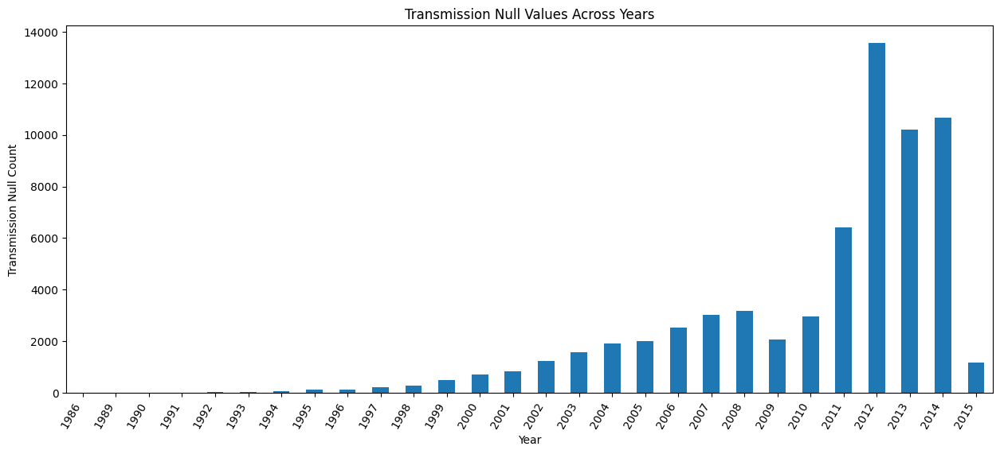

In [ ]:
plt.figure(figsize=(15,6))
null_transmission_rows['year'].value_counts().sort_index().plot(kind='bar')

plt.title('Transmission Null Values Across Years')
plt.xlabel('Year')
plt.ylabel('Transmission Null Count')
plt.xticks(rotation=60, ha='right')
plt.show()

Below is the plot of Vehicle Counts Across Years

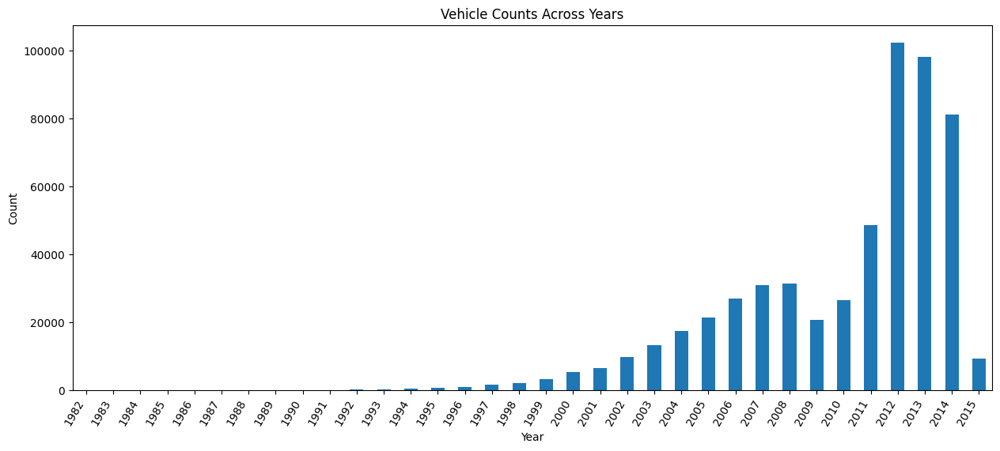

In [ ]:
plt.figure(figsize=(15,6))
df_filtered['year'].value_counts().sort_index().plot(kind='bar')

plt.title('Vehicle Counts Across Years')
plt.xlabel('Year')
plt.ylabel('Count')
plt.xticks(rotation=60, ha='right')
plt.show()

Observations from above: We see that the distribution of the number of `transmission` null values vs. `year` is similar to the distribution of the overall count of vehicles sold vs. `year`. Thus, we can proceed with dropping nulls in the `transmission` column.

Transmission type can be a significant factor in determining a vehicle's market value, performance characteristics, and desirability. Therefore, it is not wise to drop the entire column itself.

We drop rows where `transmission` is null because the dataset is large enough such that removing a subset of the data doesn't significantly reduce the overall dataset size or its ability to represent the population. Furthermore, we know that because the distributions of `transmission` nulls and overall vehicle count are similar, removing the nulls will not change up the distributions of vehicles among different years.

We now drop nulls in the `transmission` column and analyze other missing data.

In [ ]:
df_cleaned = df_filtered.dropna(subset=['transmission'])
df_cleaned['transmission'].value_counts()

transmission
automatic    475915
manual        17544
Name: count, dtype: int64

In [ ]:
missing = df_cleaned.isnull().sum()
missing

year                0
make             8540
model            8632
trim             8856
body            11032
transmission        0
vin                 0
state               0
condition        9909
odometer           63
color             595
interior          595
seller              0
mmr                11
sellingprice       11
saledate           11
dtype: int64

## Body Column - Missing Values

In [ ]:
null_body_rows = df_cleaned[pd.isnull(df_cleaned['body'])]
null_body_rows.head()

,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate
468,2013,lincoln,mkt,awd v6,NaN,automatic,2lmhj5nk1dbl52290,ca,41.0,74874.0,black,black,remarketing by ge/manheim southern california,19300.0,17750.0,Thu Dec 18 2014 12:00:00 GMT-0800 (PST)
742,2012,NaN,NaN,NaN,NaN,automatic,wbakb8c51cc964387,ca,38.0,23208.0,gray,black,financial services remarketing (lease),47200.0,46000.0,Thu Feb 26 2015 04:30:00 GMT-0800 (PST)
743,2012,bmw,750i,xdr 750i xdriv,NaN,automatic,wbakc6c5xcc395623,ca,4.0,50790.0,gray,black,financial services remarketing (lease),33900.0,33500.0,Thu Dec 18 2014 12:30:00 GMT-0800 (PST)
747,2012,NaN,NaN,NaN,NaN,automatic,wbakb8c53cc964410,ca,33.0,19785.0,beige,gray,financial services remarketing (lease),49500.0,46000.0,Thu Feb 12 2015 04:30:00 GMT-0800 (PST)
766,2012,NaN,NaN,NaN,NaN,automatic,wbakb8c54cc964089,ca,37.0,48424.0,black,black,financial services remarketing (lease),42300.0,43000.0,Thu Jan 15 2015 04:30:00 GMT-0800 (PST)


We see that there are 11032 null values in the `body` column. We can drop the nulls in the `body` column as the dataset is large enough such that removing a subset of the data doesn't significantly reduce the overall dataset size or its ability to represent the population.

In [ ]:
df_cleaned2 = df_cleaned.dropna(subset=['body'])

In [ ]:
missing = df_cleaned2.isnull().sum()
missing

year               0
make               0
model             92
trim               0
body               0
transmission       0
vin                0
state              0
condition       9433
odometer          55
color            581
interior         581
seller             0
mmr               11
sellingprice      11
saledate          11
dtype: int64

## MMR Column - Missing Values

We notice that `mmr`, `sellingprice`, and `saledate` all have 11 rows with null values. Could these be correlated somehow? The below cell explores this.

In [ ]:
# show dataframe where mmr is null
# check to see if other columns also have null values

null_mmr_rows = df_cleaned2[pd.isnull(df_cleaned2['mmr'])]
print(len(null_mmr_rows))
null_mmr_rows

11


,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate
306447,2013,Hyundai,Sonata,GLS,Sedan,automatic,5npeb4ac6dh687932,il,19.0,37254.0,gray,gray,kfl llc,NaN,NaN,NaN
406524,2013,Chrysler,300,Base,Sedan,automatic,2c3ccaag9dh723146,il,27.0,44208.0,silver,black,kfl llc,NaN,NaN,NaN
429644,2013,Chrysler,200,Touring,Sedan,automatic,1c3ccbbb9dn718531,il,25.0,47344.0,white,black,kfl llc,NaN,NaN,NaN
429660,2013,Dodge,Avenger,SXT,Sedan,automatic,1c3cdzcg5dn741076,il,34.0,44525.0,gray,black,kfl llc,NaN,NaN,NaN
429786,2013,Hyundai,Accent,GLS,Sedan,automatic,kmhct4ae7du450468,il,3.0,43135.0,silver,gray,kfl llc,NaN,NaN,NaN
431905,2013,Kia,Soul,Base,Wagon,automatic,kndjt2a5xd7765280,va,19.0,29465.0,silver,black,kfl llc,NaN,NaN,NaN
457035,2014,Hyundai,Elantra,SE,Sedan,automatic,5npdh4ae3eh504144,il,19.0,20775.0,white,—,kfl llc,NaN,NaN,NaN
457803,2013,Dodge,Charger,SE,Sedan,automatic,2c3cdxbg6dh688757,il,19.0,45355.0,white,black,kfl llc,NaN,NaN,NaN
522495,2012,Ford,Fusion,SEL,sedan,automatic,3fahp0jg5cr241590,va,26.0,51648.0,black,gray,kfl llc,NaN,NaN,NaN
537706,2012,Kia,Forte,LX,sedan,automatic,knaft4a22c5559983,md,25.0,30927.0,silver,gray,kfl llc,NaN,NaN,NaN


**Observations from above**: We see from the above dataframe that all rows with missing `mmr` values also have missing `sellingprice` and `saledate`.

We have two options here: either we can drop these rows or we can fill in the missing data with the median/mean value per column.

In this case, we chose to drop these rows because putting the median/mean in place of the missing values may skew the data if it doesn't fit the quality, condition, etc. of the vehicle. Since `sellingprice` is the target/prediction variable, it makes sense to drop these rows. Overall, it is safer to drop these null rows than create possible outliers, especially because the size of the dataset is so large.

In [ ]:
df_cleaned3 = df_cleaned2.dropna(subset=['mmr'])

In [ ]:
missing = df_cleaned3.isnull().sum()
missing

year               0
make               0
model             92
trim               0
body               0
transmission       0
vin                0
state              0
condition       9433
odometer          55
color            581
interior         581
seller             0
mmr                0
sellingprice       0
saledate           0
dtype: int64

## Color & Interior Columns - Missing Values

We notice that `color` and `interior` both have 581 rows with null values. Could these be correlated somehow? The below cell explores this.

In [ ]:
# show dataframe where color is null
# check to see if other columns also have null values

null_color_rows = df_cleaned3[pd.isnull(df_cleaned3['color'])]
null_color_rows.head()

,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate
1824,2011,BMW,M3,Base,Sedan,automatic,wbspm9c59be699111,ca,4.0,26406.0,NaN,NaN,financial services remarketing (lease),41100.0,42500.0,Thu Dec 18 2014 12:30:00 GMT-0800 (PST)
2257,2011,Mercedes-Benz,C-Class,C350 Sport,Sedan,automatic,wddgf5gbxbr146489,ca,36.0,34961.0,NaN,NaN,mercedes-benz financial services,21400.0,21500.0,Thu Dec 18 2014 12:30:00 GMT-0800 (PST)
2334,2011,Mercedes-Benz,CLS-Class,CLS550,Sedan,automatic,wdddj7cbxba169305,ca,35.0,27372.0,NaN,NaN,mercedes-benz usa,34500.0,30000.0,Thu Dec 18 2014 12:00:00 GMT-0800 (PST)
2389,2011,Mercedes-Benz,S-Class,S63 AMG,Sedan,automatic,wddng7eb3ba409875,ca,35.0,8120.0,NaN,NaN,mercedes-benz financial services,66000.0,66000.0,Thu Dec 18 2014 12:30:00 GMT-0800 (PST)
3534,2007,Nissan,Maxima,3.5 SE,Sedan,automatic,1n4ba41e57c818927,ca,NaN,97092.0,NaN,NaN,wells fargo dealer services,6500.0,3800.0,Tue Dec 16 2014 13:00:00 GMT-0800 (PST)


**Observations from above**: We see that rows with `color` missing also have `interior` missing. Thus, removing null values for `color` will also remove null values for `interior`. We can do this as the dataset is so large so removing a small subset of the data won't make a huge difference.



In [ ]:
df_cleaned4 = df_cleaned3.dropna(subset=['color'])

In [ ]:
missing = df_cleaned4.isnull().sum()
missing

year               0
make               0
model             88
trim               0
body               0
transmission       0
vin                0
state              0
condition       9401
odometer          54
color              0
interior           0
seller             0
mmr                0
sellingprice       0
saledate           0
dtype: int64

## Model Column - Missing Values

In [ ]:
# show dataframe where model is null
# check to see if other columns also have null values

null_model_rows = df_cleaned4[pd.isnull(df_cleaned4['model'])]
null_model_rows.head()

,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate
72,2014,BMW,NaN,750Li,Sedan,automatic,wbaye8c59ed134514,ca,43.0,12172.0,black,black,financial services remarketing (lease),67000.0,66000.0,Thu Dec 18 2014 12:30:00 GMT-0800 (PST)
31262,2014,BMW,NaN,750i,Sedan,automatic,wbaya8c52ed825069,ga,44.0,4488.0,silver,black,global imports,67000.0,64200.0,Thu Dec 18 2014 10:00:00 GMT-0800 (PST)
61951,2014,BMW,NaN,750Li xDrive,Sedan,automatic,wbayf8c57ed653381,oh,48.0,387.0,black,black,bmw na manheim new jersey,72000.0,72500.0,Tue Dec 30 2014 14:00:00 GMT-0800 (PST)
61955,2014,BMW,NaN,750Li xDrive,Sedan,automatic,wbayf8c51ed142328,oh,46.0,414.0,white,—,bmw na manheim new jersey,72000.0,68500.0,Tue Dec 30 2014 14:00:00 GMT-0800 (PST)
61972,2014,BMW,NaN,750Li xDrive,Sedan,automatic,wbayf8c57ed653316,oh,48.0,361.0,black,black,bmw na manheim new jersey,72000.0,78500.0,Tue Dec 30 2014 14:00:00 GMT-0800 (PST)


Observations from above: We see that no other columns are correlated with the null values in the `model` column. We can drop the missing values in the `model` column.

In [ ]:
df_cleaned5 = df_cleaned4.dropna(subset=['model'])
missing = df_cleaned5.isnull().sum()
missing

year               0
make               0
model              0
trim               0
body               0
transmission       0
vin                0
state              0
condition       9401
odometer          54
color              0
interior           0
seller             0
mmr                0
sellingprice       0
saledate           0
dtype: int64

## Odometer Column - Missing Values

Dealing with missing values in `odometer` column:
* estimate their values using the average of the values from the 5 nearest neighbors
* potentially more accurate than simpler methods like mean or median imputation

In [ ]:
from sklearn.impute import KNNImputer

imputer = KNNImputer(n_neighbors=5)
df_cleaned5[['odometer']] = imputer.fit_transform(df_cleaned5[['odometer']])

<ipython-input-100-98a28a27e33c>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
missing = df_cleaned5.isnull().sum()
missing

year               0
make               0
model              0
trim               0
body               0
transmission       0
vin                0
state              0
condition       9401
odometer           0
color              0
interior           0
seller             0
mmr                0
sellingprice       0
saledate           0
dtype: int64

## Condition Column - Missing Values

Dealing with missing values in `condition` column
* employing regression imputation using a linear regression model to estimate missing values for the condition column in a dataset
* using numerical predictors of this column

In [ ]:
from sklearn.linear_model import LinearRegression

df_known = df_cleaned5.dropna(subset=['condition'])
df_unknown = df_cleaned5[df_cleaned5['condition'].isna()]

X_known = df_known[['year', 'odometer', 'mmr']]
y_known = df_known['condition']

model = LinearRegression()
model.fit(X_known, y_known)

X_unknown = df_unknown[['year', 'odometer', 'mmr']]
predicted_conditions = model.predict(X_unknown)

df_cleaned5.loc[df_cleaned5['condition'].isna(), 'condition'] = predicted_conditions

In [ ]:
missing = df_cleaned5.isnull().sum()
missing

year            0
make            0
model           0
trim            0
body            0
transmission    0
vin             0
state           0
condition       0
odometer        0
color           0
interior        0
seller          0
mmr             0
sellingprice    0
saledate        0
dtype: int64

In [ ]:
df_cleaned5.head()

,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate
0,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg566472,ca,5.0,16639.0,white,black,kia motors america inc,20500.0,21500.0,Tue Dec 16 2014 12:30:00 GMT-0800 (PST)
1,2015,Kia,Sorento,LX,SUV,automatic,5xyktca69fg561319,ca,5.0,9393.0,white,beige,kia motors america inc,20800.0,21500.0,Tue Dec 16 2014 12:30:00 GMT-0800 (PST)
2,2014,BMW,3 Series,328i SULEV,Sedan,automatic,wba3c1c51ek116351,ca,45.0,1331.0,gray,black,financial services remarketing (lease),31900.0,30000.0,Thu Jan 15 2015 04:30:00 GMT-0800 (PST)
3,2015,Volvo,S60,T5,Sedan,automatic,yv1612tb4f1310987,ca,41.0,14282.0,white,black,volvo na rep/world omni,27500.0,27750.0,Thu Jan 29 2015 04:30:00 GMT-0800 (PST)
4,2014,BMW,6 Series Gran Coupe,650i,Sedan,automatic,wba6b2c57ed129731,ca,43.0,2641.0,gray,black,financial services remarketing (lease),66000.0,67000.0,Thu Dec 18 2014 12:30:00 GMT-0800 (PST)


## String Cleaning

Using regex to clean up `color` and `interior` strings

In [ ]:
df_cleaned5['color'] = df_cleaned5['color'].replace(r'^—$', None, regex=True)
df_cleaned5['interior'] = df_cleaned5['interior'].replace(r'^—$', None, regex=True)
df_cleaned_6 = df_cleaned5.dropna(subset=['color', 'interior'])

<ipython-input-105-ade1ea9abfe2>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-105-ade1ea9abfe2>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
#ALL NULLS MISSING
vehicles = df_cleaned_6

Fixing data to be case insensitive (i.e. Sedan = sedan in practical terms so the data should reflect that) for categorical columns

In [ ]:
#Make - all uppercase so good!

#Model - difference in cases matters for this since i8 is different from I8 in another car brand

#Trim

vehicles['trim'] = vehicles['trim'].apply(lambda x: x.lower())
print(vehicles['trim'].unique())

#Body - there is upper and lower case need to fix this

vehicles['body'] = vehicles['body'].apply(lambda x: x.lower())
print(vehicles['body'].unique())

#Transmission - no upper case all good
print(vehicles['transmission'].unique())

#State - no upper case; all good
print( vehicles['state'].unique())

#Color - no upper case; all good
print(vehicles['color'].unique())

#Interior - no upper case; all good
vehicles['interior'].unique()

<ipython-input-107-d0458e0f74ab>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-107-d0458e0f74ab>:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



['lx' '328i sulev' 't5' ... '4.2 quattro spyder' 'ewb' 'power wagon']
['suv' 'sedan' 'convertible' 'coupe' 'wagon' 'hatchback' 'crew cab'
 'g coupe' 'g sedan' 'elantra coupe' 'genesis coupe' 'minivan' 'van'
 'double cab' 'king cab' 'cts coupe' 'supercrew' 'e-series van'
 'extended cab' 'supercab' 'g convertible' 'koup' 'regular cab' 'quad cab'
 'crewmax cab' 'cts-v coupe' 'g37 convertible' 'access cab' 'club cab'
 'xtracab' 'q60 convertible' 'cts wagon' 'g37 coupe' 'mega cab'
 'cab plus 4' 'q60 coupe' 'cab plus' 'tsx sport wagon'
 'promaster cargo van' 'beetle convertible' 'granturismo convertible'
 'cts-v wagon' 'regular-cab' 'transit van']
['automatic' 'manual']
['ca' 'tx' 'mn' 'az' 'wi' 'tn' 'md' 'pa' 'fl' 'ne' 'oh' 'mi' 'nj' 'va'
 'sc' 'nc' 'in' 'il' 'co' 'ut' 'ga' 'mo' 'nv' 'ma' 'pr' 'ny' 'or' 'wa'
 'la' 'hi' 'ok' 'ms' 'nm' 'al']
['white' 'gray' 'black' 'red' 'silver' 'blue' 'brown' 'beige' 'purple'
 'burgundy' 'gold' 'yellow' 'green' 'charcoal' 'orange' 'off-white'
 'turquoise' '

array(['black', 'beige', 'tan', 'gray', 'brown', 'burgundy', 'white',
       'silver', 'off-white', 'red', 'yellow', 'blue', 'green', 'purple',
       'orange', 'gold'], dtype=object)

In [ ]:
vehicles.head()

,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate
0,2015,Kia,Sorento,lx,suv,automatic,5xyktca69fg566472,ca,5.0,16639.0,white,black,kia motors america inc,20500.0,21500.0,Tue Dec 16 2014 12:30:00 GMT-0800 (PST)
1,2015,Kia,Sorento,lx,suv,automatic,5xyktca69fg561319,ca,5.0,9393.0,white,beige,kia motors america inc,20800.0,21500.0,Tue Dec 16 2014 12:30:00 GMT-0800 (PST)
2,2014,BMW,3 Series,328i sulev,sedan,automatic,wba3c1c51ek116351,ca,45.0,1331.0,gray,black,financial services remarketing (lease),31900.0,30000.0,Thu Jan 15 2015 04:30:00 GMT-0800 (PST)
3,2015,Volvo,S60,t5,sedan,automatic,yv1612tb4f1310987,ca,41.0,14282.0,white,black,volvo na rep/world omni,27500.0,27750.0,Thu Jan 29 2015 04:30:00 GMT-0800 (PST)
4,2014,BMW,6 Series Gran Coupe,650i,sedan,automatic,wba6b2c57ed129731,ca,43.0,2641.0,gray,black,financial services remarketing (lease),66000.0,67000.0,Thu Dec 18 2014 12:30:00 GMT-0800 (PST)


## Creating Datetime Objects & Renaming Columns

[link text](https:// [link text](https://))Converting `saledate` to datetime to extract key information

In [ ]:
vehicles['saledate'] = pd.to_datetime(vehicles['saledate'], utc=True)
vehicles['saledate'] = vehicles['saledate'].dt.tz_convert(None)
vehicles['saledate'] = pd.to_datetime(vehicles['saledate'], errors='coerce', utc=True)

print(vehicles['saledate'].dtype)

vehicles['saleyear'] = vehicles['saledate'].dt.year
vehicles['saledate'] = vehicles['saledate'].dt.date

vehicles.head()

<ipython-input-109-c1b12561bc84>:1: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

<ipython-input-109-c1b12561bc84>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-109-c1b12561bc84>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-109-c1b12561bc84>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFram

datetime64[ns, UTC]


<ipython-input-109-c1b12561bc84>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,year,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate,saleyear
0,2015,Kia,Sorento,lx,suv,automatic,5xyktca69fg566472,ca,5.0,16639.0,white,black,kia motors america inc,20500.0,21500.0,2014-12-16,2014
1,2015,Kia,Sorento,lx,suv,automatic,5xyktca69fg561319,ca,5.0,9393.0,white,beige,kia motors america inc,20800.0,21500.0,2014-12-16,2014
2,2014,BMW,3 Series,328i sulev,sedan,automatic,wba3c1c51ek116351,ca,45.0,1331.0,gray,black,financial services remarketing (lease),31900.0,30000.0,2015-01-14,2015
3,2015,Volvo,S60,t5,sedan,automatic,yv1612tb4f1310987,ca,41.0,14282.0,white,black,volvo na rep/world omni,27500.0,27750.0,2015-01-28,2015
4,2014,BMW,6 Series Gran Coupe,650i,sedan,automatic,wba6b2c57ed129731,ca,43.0,2641.0,gray,black,financial services remarketing (lease),66000.0,67000.0,2014-12-18,2014


In [ ]:
vehicles.rename(columns={'year': 'manufactureyear'},inplace=True)
vehicles.head()

<ipython-input-55-98e7d902fe1e>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,manufactureyear,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate,saleyear
0,2015,Kia,Sorento,lx,suv,automatic,5xyktca69fg566472,ca,5.0,16639.0,white,black,kia motors america inc,20500.0,21500.0,2014-12-16,2014
1,2015,Kia,Sorento,lx,suv,automatic,5xyktca69fg561319,ca,5.0,9393.0,white,beige,kia motors america inc,20800.0,21500.0,2014-12-16,2014
2,2014,BMW,3 Series,328i sulev,sedan,automatic,wba3c1c51ek116351,ca,45.0,1331.0,gray,black,financial services remarketing (lease),31900.0,30000.0,2015-01-14,2015
3,2015,Volvo,S60,t5,sedan,automatic,yv1612tb4f1310987,ca,41.0,14282.0,white,black,volvo na rep/world omni,27500.0,27750.0,2015-01-28,2015
4,2014,BMW,6 Series Gran Coupe,650i,sedan,automatic,wba6b2c57ed129731,ca,43.0,2641.0,gray,black,financial services remarketing (lease),66000.0,67000.0,2014-12-18,2014


In [ ]:
df_cat = vehicles #final df with categorical variables still present
df_cat.head()

,manufactureyear,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate,saleyear
0,2015,Kia,Sorento,lx,suv,automatic,5xyktca69fg566472,ca,5.0,16639.0,white,black,kia motors america inc,20500.0,21500.0,2014-12-16,2014
1,2015,Kia,Sorento,lx,suv,automatic,5xyktca69fg561319,ca,5.0,9393.0,white,beige,kia motors america inc,20800.0,21500.0,2014-12-16,2014
2,2014,BMW,3 Series,328i sulev,sedan,automatic,wba3c1c51ek116351,ca,45.0,1331.0,gray,black,financial services remarketing (lease),31900.0,30000.0,2015-01-14,2015
3,2015,Volvo,S60,t5,sedan,automatic,yv1612tb4f1310987,ca,41.0,14282.0,white,black,volvo na rep/world omni,27500.0,27750.0,2015-01-28,2015
4,2014,BMW,6 Series Gran Coupe,650i,sedan,automatic,wba6b2c57ed129731,ca,43.0,2641.0,gray,black,financial services remarketing (lease),66000.0,67000.0,2014-12-18,2014


# Exploratory Data Analysis + Feature Engineering

Creating vehicle age column

In [ ]:
df_cat['vehicle_age'] = df_cat['saleyear'] - df_cat['manufactureyear']
df_cat.head()

<ipython-input-57-2f6e54580c7e>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,manufactureyear,make,model,trim,body,transmission,vin,state,condition,odometer,color,interior,seller,mmr,sellingprice,saledate,saleyear,vehicle_age
0,2015,Kia,Sorento,lx,suv,automatic,5xyktca69fg566472,ca,5.0,16639.0,white,black,kia motors america inc,20500.0,21500.0,2014-12-16,2014,-1
1,2015,Kia,Sorento,lx,suv,automatic,5xyktca69fg561319,ca,5.0,9393.0,white,beige,kia motors america inc,20800.0,21500.0,2014-12-16,2014,-1
2,2014,BMW,3 Series,328i sulev,sedan,automatic,wba3c1c51ek116351,ca,45.0,1331.0,gray,black,financial services remarketing (lease),31900.0,30000.0,2015-01-14,2015,1
3,2015,Volvo,S60,t5,sedan,automatic,yv1612tb4f1310987,ca,41.0,14282.0,white,black,volvo na rep/world omni,27500.0,27750.0,2015-01-28,2015,0
4,2014,BMW,6 Series Gran Coupe,650i,sedan,automatic,wba6b2c57ed129731,ca,43.0,2641.0,gray,black,financial services remarketing (lease),66000.0,67000.0,2014-12-18,2014,0


In [ ]:
#This is the case with pre-ordering vehicles prior to the date they are manufacture dmost likely
df_cat['vehicle_age'] = df_cat['vehicle_age'].replace(-1, 0)

<ipython-input-58-ff67f28dda11>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<Figure size 1500x600 with 0 Axes>

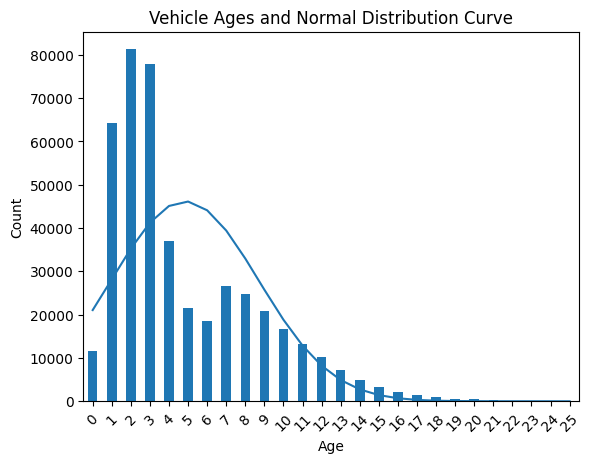

In [ ]:
import scipy.stats as stats
plt.figure(figsize=(15,6))
fig, ax = plt.subplots()
df_cat['vehicle_age'].value_counts().sort_index().plot(kind='bar', ax=ax)

plt.title('Vehicle Ages and Normal Distribution Curve')
plt.xlabel('Age')
plt.ylabel('Count')
plt.xticks(rotation=45)

df_mean = np.mean(df_cat["vehicle_age"])
df_std = np.std(df_cat["vehicle_age"])

pdf = stats.norm.pdf(df_cat["vehicle_age"].sort_values(), df_mean, df_std)

ax.plot(df_cat["vehicle_age"].sort_values(), pdf * len(df_cat["vehicle_age"]))

plt.show()

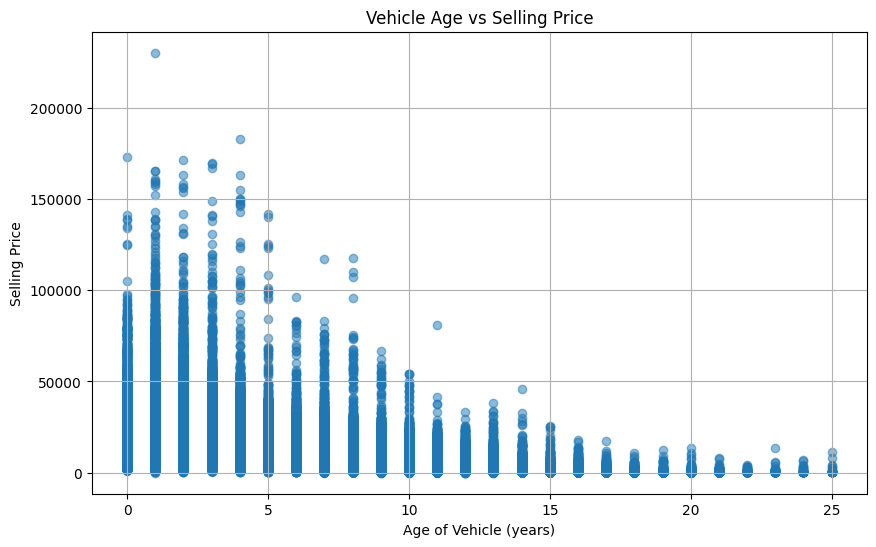

In [ ]:
plt.figure(figsize=(10, 6))
plt.scatter(vehicles['vehicle_age'], vehicles['sellingprice'], alpha=0.5)
plt.title('Vehicle Age vs Selling Price')
plt.xlabel('Age of Vehicle (years)')
plt.ylabel('Selling Price')
plt.grid(True)
plt.show()

Observations:

* vehicle age distribution and vehicle age vs selling price both right skewed

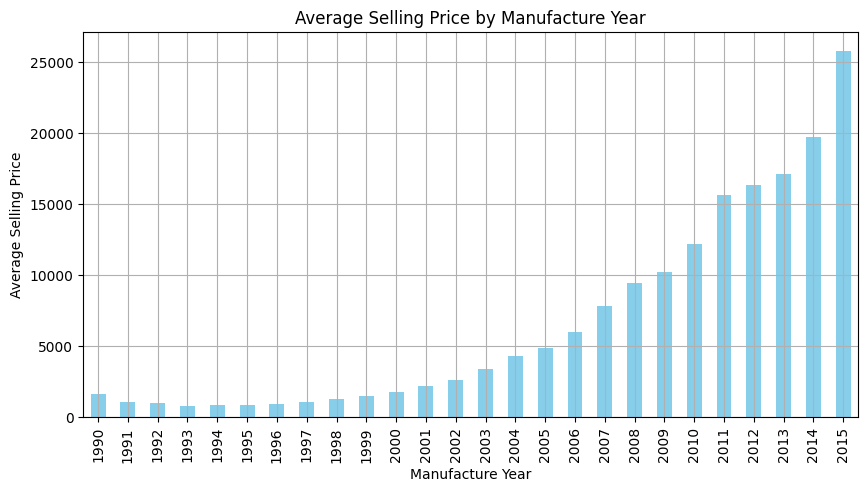

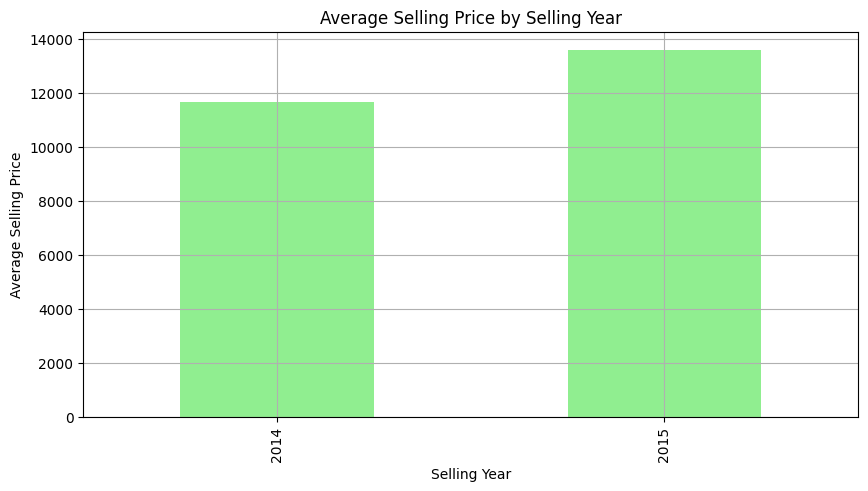

In [ ]:
avg_price_by_manufacture_year = df_cat.groupby('manufactureyear')['sellingprice'].mean()

avg_price_by_selling_year = df_cat.groupby('saleyear')['sellingprice'].mean()

fig, ax = plt.subplots(figsize=(10,5))

avg_price_by_manufacture_year.plot(kind='bar', color='skyblue', ax=ax)
plt.title('Average Selling Price by Manufacture Year')
plt.xlabel('Manufacture Year')
plt.ylabel('Average Selling Price')
plt.grid(True)
avg_price_by_manufacture_year_reset = avg_price_by_manufacture_year.reset_index()
plt.show()

plt.figure(figsize=(10, 5))
avg_price_by_selling_year.plot(kind='bar', color='lightgreen')
plt.title('Average Selling Price by Selling Year')
plt.xlabel('Selling Year')
plt.ylabel('Average Selling Price')
plt.grid(True)

Observations:
* manufacture year ranges from 1990 to 2015
* selling year ranges from 2014 to 2015

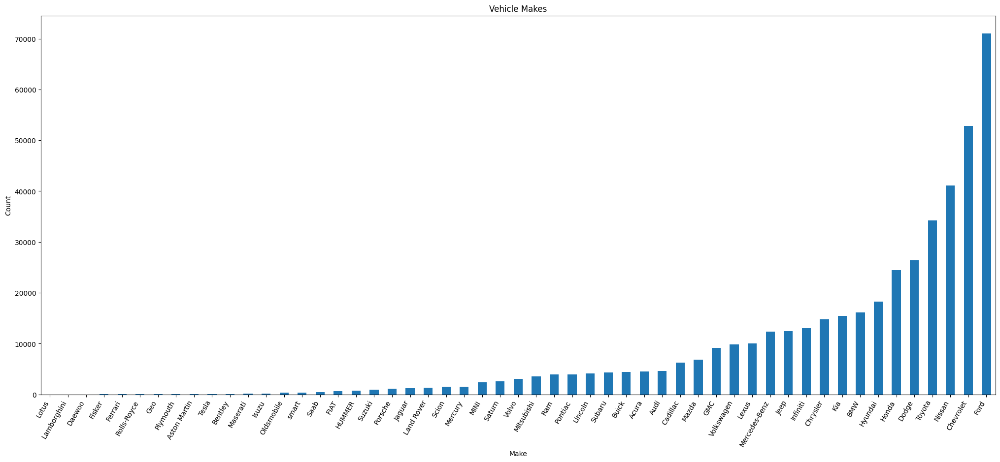

In [ ]:
plt.figure(figsize=(25,10))
df_cat['make'].value_counts().sort_values(ascending=True).plot(kind='bar')

plt.title('Vehicle Makes')
plt.xlabel('Make')
plt.ylabel('Count')
plt.xticks(rotation=60, ha='right')
plt.show()

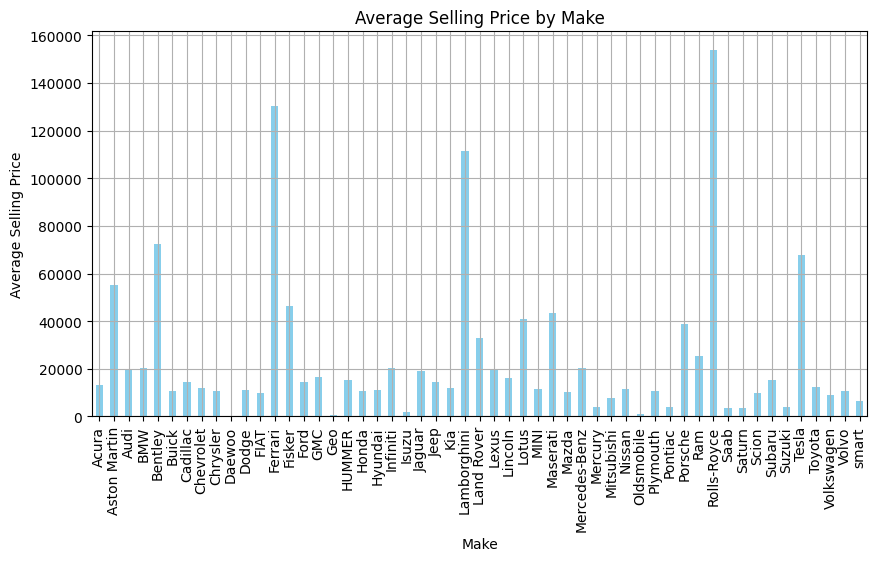

In [ ]:
avg_price_by_make = df_cat.groupby('make')['sellingprice'].mean()

plt.figure(figsize=(10, 5))
avg_price_by_make.plot(kind='bar', color='skyblue')
plt.title('Average Selling Price by Make')
plt.xlabel('Make')
plt.ylabel('Average Selling Price')
plt.grid(True)
plt.show()

In [ ]:
df_cat['trim'].value_counts()

trim
base                46421
se                  35581
lx                  18318
lt                  14897
limited             14226
                    ...  
premium fleet           1
premium cartier         1
ws                      1
gls vr6 (1999.5)        1
power wagon             1
Name: count, Length: 1474, dtype: int64

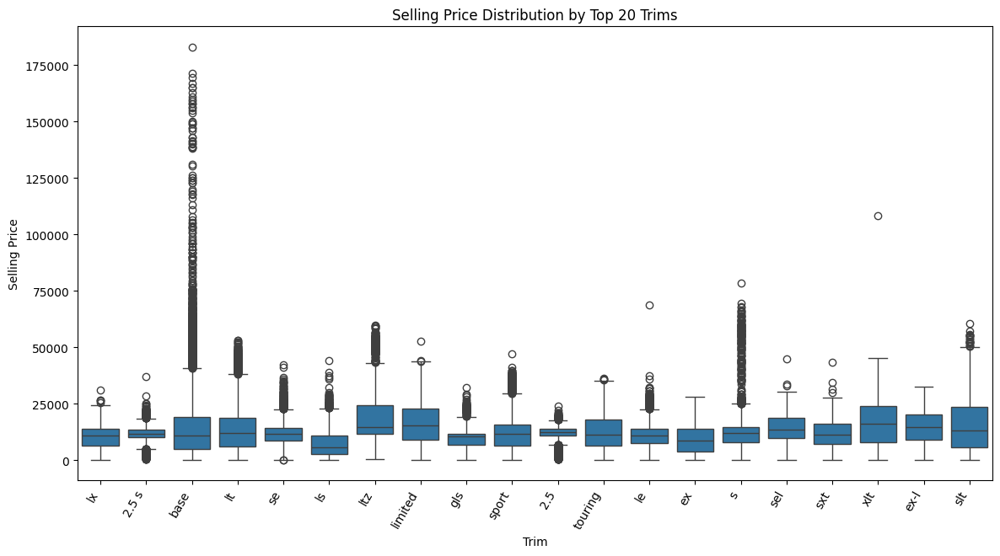

In [ ]:
trim_price_stats = df_cat.groupby('trim')['sellingprice'].agg(['mean', 'median', 'std', 'count']).sort_values(by='count', ascending=False)

top_trims = trim_price_stats.head(20)

plt.figure(figsize=(14, 7))
sns.boxplot(x='trim', y='sellingprice', data=df_cat[df_cat['trim'].isin(top_trims.index)])
plt.xticks(rotation=60, ha='right')
plt.title('Selling Price Distribution by Top 20 Trims')
plt.xlabel('Trim')
plt.ylabel('Selling Price')
plt.show()

Observations:

* many, many unique values of Trim
* when plotting, see theat there is a difference in selling price based on trim --> shouldn't drop column but need to figure out how to encode

In [ ]:
df_cat['state'].value_counts()

state
fl    70218
ca    62894
tx    38505
ga    29864
pa    23202
nj    21557
il    20688
oh    19248
nc    18021
mi    14214
mo    14198
tn    13921
nv    10483
md     9452
va     9247
wi     8710
mn     8054
az     7930
wa     6908
co     6213
ma     6161
ny     5278
ne     3911
in     3902
sc     3708
pr     2432
la     1711
ut     1697
ms     1581
hi     1128
or     1028
nm      142
ok       52
al       25
Name: count, dtype: int64

In [ ]:
import plotly.graph_objs as go
import pandas as pd

state_counts = {
    'State': ['FL', 'CA', 'TX', 'GA', 'PA', 'NJ', 'IL', 'OH', 'NC', 'MI', 'MO',
              'TN', 'NV', 'MD', 'VA', 'WI', 'MN', 'AZ', 'WA', 'CO', 'MA', 'NY',
              'NE', 'IN', 'SC', 'PR', 'LA', 'UT', 'MS', 'HI', 'OR', 'NM', 'OK', 'AL'],
    'Count': [70218, 62894, 38505, 29864, 23202, 21557, 20688, 19248, 18021, 14214,
              14198, 13921, 10483, 9452, 9247, 8710, 8054, 7930, 6908, 6213, 6161, 5278,
              3911, 3902, 3708, 2432, 1711, 1697, 1581, 1128, 1028, 142, 52, 25]
}

df = pd.DataFrame(state_counts)

fig = go.Figure(data=go.Choropleth(
    locations=df['State'],
    z=df['Count'].astype(float),
    locationmode='USA-states',
    colorscale='Reds',
    colorbar_title="Count",
))

fig.update_layout(
    title_text='Geographical Plot by State Count',
    geo_scope='usa',
)

fig.show()

In [ ]:
fig = px.scatter(df_cat, x='mmr', y='sellingprice', color='body', title='MMR vs. Selling Price by Body Type', trendline='ols')
fig.show()

trendline_data = fig.data

print(trendline_data)
#print("Trendline Equation:", trendline_data['text'][0])
#print("R-squared:", trendline_data['name'])


(Scattergl({
    'hovertemplate': 'body=suv<br>mmr=%{x}<br>sellingprice=%{y}<extra></extra>',
    'legendgroup': 'suv',
    'marker': {'color': '#636efa', 'symbol': 'circle'},
    'mode': 'markers',
    'name': 'suv',
    'showlegend': True,
    'x': array([20500., 20800., 20600., ..., 29800., 26000., 29800.]),
    'xaxis': 'x',
    'y': array([21500., 21500., 21500., ..., 17300., 24500., 34000.]),
    'yaxis': 'y'
}), Scattergl({
    'hovertemplate': ('<b>OLS trendline</b><br>sellin' ... ' <b>(trend)</b><extra></extra>'),
    'legendgroup': 'suv',
    'marker': {'color': '#636efa', 'symbol': 'circle'},
    'mode': 'lines',
    'name': 'suv',
    'showlegend': False,
    'x': array([2.50e+01, 2.50e+01, 2.50e+01, ..., 1.36e+05, 1.43e+05, 1.43e+05]),
    'xaxis': 'x',
    'y': array([5.31955375e+01, 5.31955375e+01, 5.31955375e+01, ..., 1.34586088e+05,
                1.41511848e+05, 1.41511848e+05]),
    'yaxis': 'y'
}), Scattergl({
    'hovertemplate': 'body=sedan<br>mmr=%{x}<br>selling

Observations:

* trend between MMR and selling price very very linear --> might want to drop this column because causes data leaks for linear regression

In [ ]:
fig = px.scatter(df_cat, x='odometer', y='sellingprice', color='manufactureyear', title='Odometer Reading vs. Selling Price')
fig.show()

Observations:

* Non-linear relationship between odometer and selling price (decreases quite fast in the beginning then slows down)
* data points farther to right and below associated with older made vehicles

In [ ]:
fig = px.box(df_cat, x='make', y='condition', title='Condition Score Distribution by Make')
fig.show()

In [ ]:
df_cat.rename(columns={'color':'exterior'},inplace=True)
df_cat.head()

<ipython-input-71-46afae5c8cdc>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,manufactureyear,make,model,trim,body,transmission,vin,state,condition,odometer,exterior,interior,seller,mmr,sellingprice,saledate,saleyear,vehicle_age
0,2015,Kia,Sorento,lx,suv,automatic,5xyktca69fg566472,ca,5.0,16639.0,white,black,kia motors america inc,20500.0,21500.0,2014-12-16,2014,0
1,2015,Kia,Sorento,lx,suv,automatic,5xyktca69fg561319,ca,5.0,9393.0,white,beige,kia motors america inc,20800.0,21500.0,2014-12-16,2014,0
2,2014,BMW,3 Series,328i sulev,sedan,automatic,wba3c1c51ek116351,ca,45.0,1331.0,gray,black,financial services remarketing (lease),31900.0,30000.0,2015-01-14,2015,1
3,2015,Volvo,S60,t5,sedan,automatic,yv1612tb4f1310987,ca,41.0,14282.0,white,black,volvo na rep/world omni,27500.0,27750.0,2015-01-28,2015,0
4,2014,BMW,6 Series Gran Coupe,650i,sedan,automatic,wba6b2c57ed129731,ca,43.0,2641.0,gray,black,financial services remarketing (lease),66000.0,67000.0,2014-12-18,2014,0


In [ ]:
df_cat['seller'].nunique()

12407

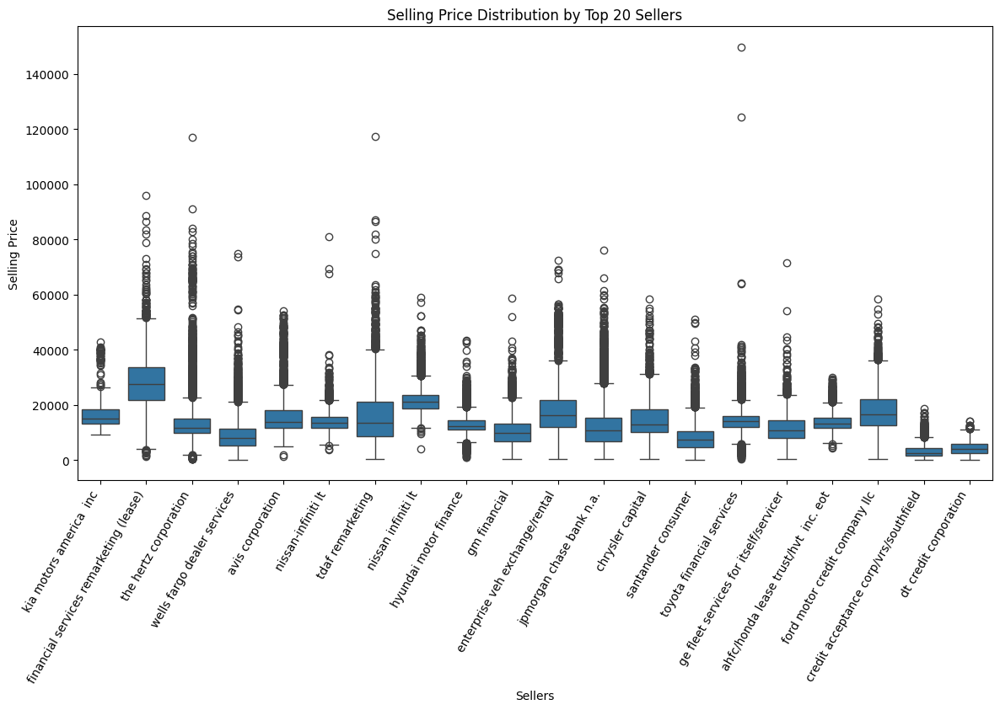

In [ ]:
seller_price_stats = df_cat.groupby('seller')['sellingprice'].agg(['mean', 'median', 'std', 'count']).sort_values(by='count', ascending=False)

top_sellers = seller_price_stats.head(20)

plt.figure(figsize=(14, 7))
sns.boxplot(x='seller', y='sellingprice', data=df_cat[df_cat['seller'].isin(top_sellers.index)])
plt.xticks(rotation=60, ha='right')
plt.title('Selling Price Distribution by Top 20 Sellers')
plt.xlabel('Sellers')
plt.ylabel('Selling Price')
plt.show()

Feature engineering color_duo feature to see if assessing both in combination has impact on selling price

In [ ]:
df_cat['color_duo'] = df_cat['exterior'] + '_' + df_cat['interior']
df_cat['color_duo'].value_counts()

<ipython-input-74-4e8bd3f4edfa>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



color_duo
black_black         52438
gray_black          35717
silver_black        35087
white_black         31846
silver_gray         30813
                    ...  
yellow_off-white        1
pink_beige              1
gold_yellow             1
beige_burgundy          1
purple_yellow           1
Name: count, Length: 219, dtype: int64

In [ ]:
df_cat['exterior'].value_counts()

exterior
black        92423
white        88017
silver       70791
gray         70029
blue         42651
red          36999
gold          9553
green         9235
burgundy      7603
beige         7467
brown         5533
orange        1729
purple        1268
off-white     1238
yellow        1077
charcoal       429
turquoise      193
pink            36
lime            12
Name: count, dtype: int64

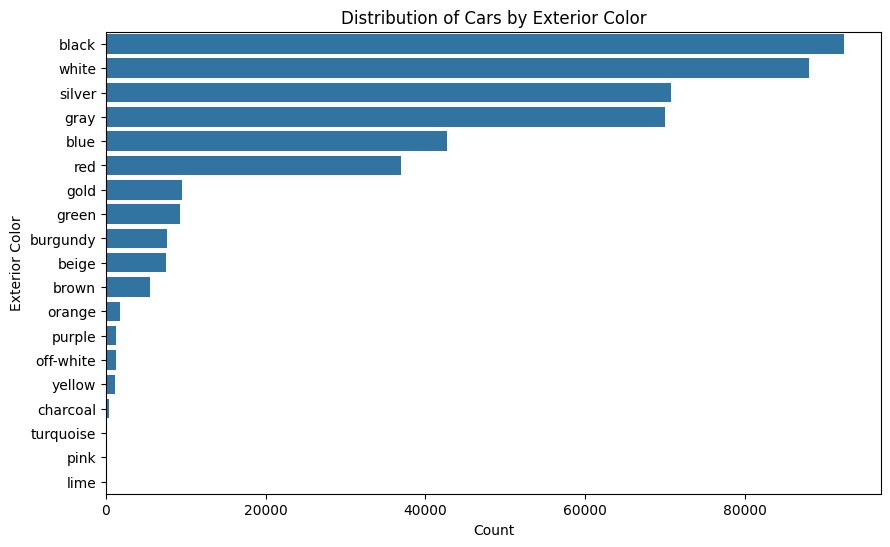

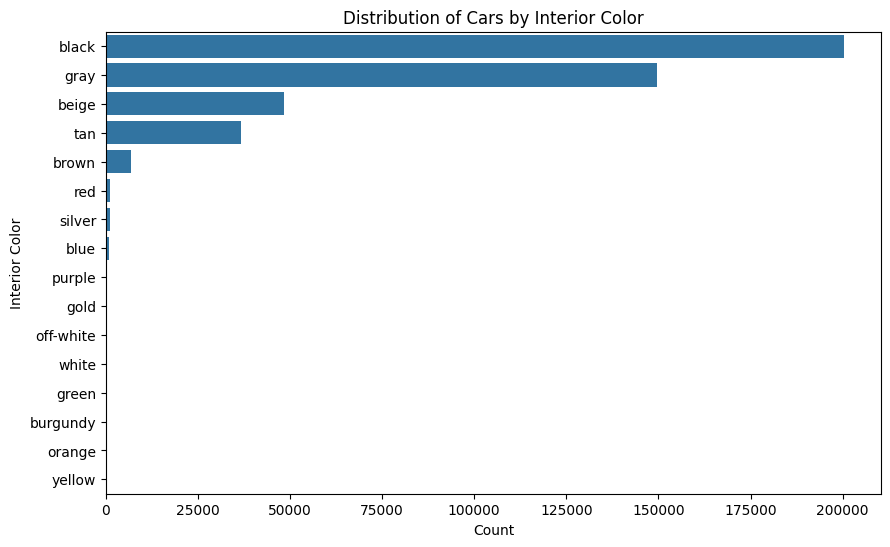

In [ ]:
plt.figure(figsize=(10, 6))
sns.countplot(y='exterior', data=df_cat, order=df_cat['exterior'].value_counts().index)
plt.title('Distribution of Cars by Exterior Color')
plt.xlabel('Count')
plt.ylabel('Exterior Color')
plt.show()

plt.figure(figsize=(10, 6))
sns.countplot(y='interior', data=df_cat, order=df_cat['interior'].value_counts().index)
plt.title('Distribution of Cars by Interior Color')
plt.xlabel('Count')
plt.ylabel('Interior Color')
plt.show()

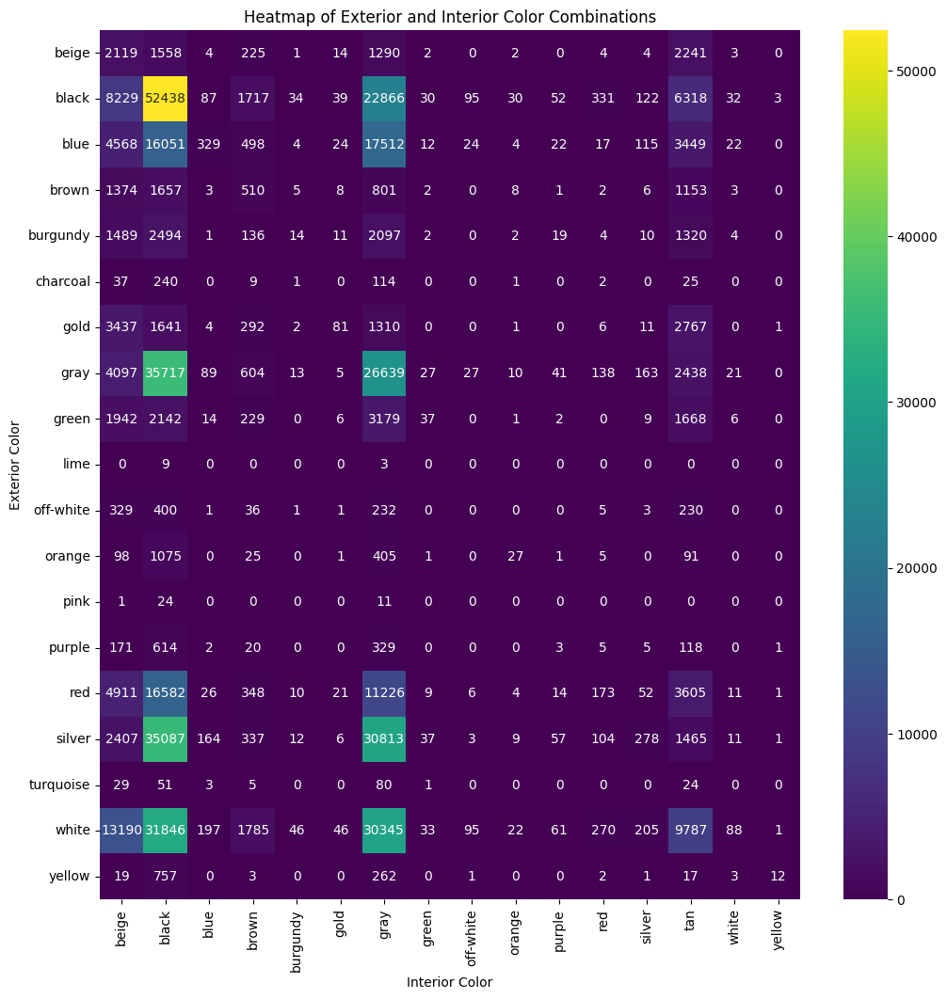

In [ ]:
color_combo = pd.crosstab(df_cat['exterior'], df_cat['interior'])

plt.figure(figsize=(12, 12))
sns.heatmap(color_combo, cmap='viridis', annot=True, fmt='g')
plt.title('Heatmap of Exterior and Interior Color Combinations')
plt.xlabel('Interior Color')
plt.ylabel('Exterior Color')
plt.show()

Observations:


*  Indicates high level of black on black interior and exterior duos as well as gray on black



# SQL Analysis

In [ ]:
!pip install pandasql

  Preparing metadata (setup.py) ... done
  Created wheel for pandasql: filename=pandasql-0.7.3-py3-none-any.whl size=26771 sha256=9f74597a1c6ab5560695cd4d500278fa1d0da473b7a13c3bb9610652721da106
  Stored in directory: /root/.cache/pip/wheels/e9/bc/3a/8434bdcccf5779e72894a9b24fecbdcaf97940607eaf4bcdf9
Successfully built pandasql


In [ ]:
from pandasql import sqldf
pysqldf = lambda q: sqldf(q, globals())

query = """
SELECT manufactureyear, make, AVG(sellingprice) as avg_price
FROM df_cat
WHERE condition > 30 AND odometer < 50000
GROUP BY manufactureyear, make
ORDER BY avg_price DESC
"""
result = pysqldf(query)
print(result)

Observations:

* Brands like Ferrari and Rolls-Royce dominate the top of the list, indicating that on average, these brands' vehicles from specific years (2011, 2013, and 2012) fetch the highest selling prices in the dataset. For instance:
* A 2011 Ferrari has an average selling price of approximately 183,000.
* Rolls-Royce vehicles from 2013 and 2012 have average selling prices of about 171,500 and 168,500, respectively.
* Brands like Buick, Oldsmobile, Toyota, Jaguar, and Jeep from the early 2000s and even late 1990s are at the bottom of the list. For example:
* A 2001 Toyota has an extremely low average selling price of 400.
* A 2000 Jeep fetches the lowest average price at 300.


In [ ]:
query = """
SELECT saledate, sellingprice, SUM(sellingprice) OVER (ORDER BY saledate) as cumulative_sales
FROM df_cat
"""
result = pysqldf(query)
print(result)

Observations:

* cumulative sum of selling prices over time, grouped by the sale date, which helps illustrate the total revenue accrued from vehicle sales at different points in time
* cumulative sales column shows that by the end of the data on July 20, 2015, total sales amounted to approximately 5.982 billion, reflecting a significant volume of transactions over the period
* Each row lists the selling price for an individual sale and the cumulative total up to that date, indicating that on the first recorded day of sales (January 1, 2014), a total of approximately 514,600 was generated from the sales, providing insights into daily revenue fluctuations and the overall financial impact of vehicle sales over time








In [ ]:
query = """
SELECT body, manufactureyear, condition, AVG(sellingprice) as avg_price
FROM df_cat
WHERE condition IS NOT NULL AND body IS NOT NULL
GROUP BY body, manufactureyear, condition
ORDER BY body, avg_price DESC
"""
result = pysqldf(query)
print(result)

Observations:

* this gets the average selling prices of vehicles, segmented by body type, manufacture year, and condition, highlighting how these factors collectively influence vehicle valuation in the market
* data indicates that for a specific body type, such as the 'access cab', newer vehicles (e.g., 2014) and those in better condition (e.g., condition ratings of 45 and 46) tend to have higher average selling prices, demonstrating the premium placed on newer, well-maintained vehicles
* older models like the 'xtracab' from the early 2000s with lower condition ratings (e.g., 2 and 19) fetch significantly lower average prices, underscoring the depreciation impact due to aging and wear

# Feature Encoding

In [ ]:
df_cat.head()

In [ ]:
df_cat['make'].nunique(), df_cat['model'].nunique(),  df_cat['trim'].nunique(),  df_cat['body'].nunique(), df_cat['transmission'].nunique(), df_cat['state'].nunique(), df_cat['exterior'].nunique(), df_cat['interior'].nunique(), df_cat['seller'].nunique(), df_cat['color_duo'].nunique()

In [ ]:
df_cat['transmission'] = df_cat['transmission'].map({'automatic': 0, 'manual': 1})

Task: Hex Color Encoding for Interior and Exterior


*   This is to transform colors into numerical values for the model as well as to create associations between colors (i.e. gray is close to black numerically so a gray car is more similar to black car compared to red car)


---




In [ ]:
import matplotlib.colors as mcolors
colors = df_cat['interior'].unique()
colors
num = {}
nonNum = []
for c in colors:
  if mcolors.is_color_like(c):
      hex = mcolors.rgb2hex(c)
      num[c] = int(hex[1:],16)
  else:
      nonNum.append(c)

print("Non-numerical colors: ", nonNum) #only remaining colors are burgundy + off-white
burgundy = int('800020', 16)
num[nonNum[0]] = burgundy
off_white = int('F8F8F8', 16)
num[nonNum[1]] = off_white
print(num)

df_cat['interior'] = df_cat['interior'].apply(lambda x: num[x])
df_cat.head(15)


In [ ]:
colors = df_cat['exterior'].unique()
colors
num = {}
nonNum = []
for c in colors:
  if mcolors.is_color_like(c):
      hex = mcolors.rgb2hex(c)
      num[c] = int(hex[1:],16)
  else:
      nonNum.append(c)

burgundy = int('800020', 16)
num[nonNum[0]] = burgundy
charcoal = int('36454F', 16)
num[nonNum[1]] = charcoal
off_white = int('F8F8F8', 16)
num[nonNum[2]] = off_white

df_cat['exterior'] = df_cat['exterior'].apply(lambda x: num[x])
df_cat.head(15)

In [ ]:
df_cat['color_duo'] = df_cat['exterior'] + df_cat['interior']
df_cat.head()

Dropping vin because unique identifier and doesn't have impact on selling price. Dropping trim and seller because too large amout of unique values

In [ ]:
df_cat.drop(columns=['vin', 'trim', 'seller'], inplace=True)

In [ ]:
df_cat.head()

In [ ]:
df_cat['body'].value_counts()

Feature encoding by grouping body into size based categories


*   This was done because there were too many unique values for body that wouldn't have been easily One Hot Encoded nor ordinally encoded

* This still allows the model to distinguish between general body types but the precision of prediction between a "g coupe" and "genesis coupe" isn't necessary given how much it would blow up the dataset size


In [ ]:
small_bodies = [
    'hatchback', 'coupe', 'convertible', 'g coupe', 'genesis coupe', 'elantra coupe',
    'beetle convertible', 'q60 coupe', 'q60 convertible', 'cts coupe', 'cts-v coupe',
    'g37 convertible', 'g37 coupe', 'koup', 'granturismo convertible'
]

medium_bodies = [
    'sedan', 'g sedan', 'wagon', 'minivan', 'tsx sport wagon', 'cts wagon', 'cts-v wagon'
]

large_bodies = [
    'suv', 'crew cab', 'supercrew', 'regular cab', 'extended cab', 'supercab', 'quad cab',
    'van', 'double cab', 'e-series van', 'crewmax cab', 'king cab', 'access cab', 'mega cab',
    'transit van', 'promaster cargo van', 'regular-cab', 'cab plus 4', 'cab plus'
]

def classify_body(body):
    if body in small_bodies:
        return 'small'
    elif body in medium_bodies:
        return 'medium'
    elif body in large_bodies:
        return 'large'
    else:
        return 'unknown'

In [ ]:
df_cat['body'] = df_cat['body'].apply(classify_body)

In [ ]:
df_cat['body'].value_counts()

In [ ]:
df_cat = df_cat[df_cat['body'] != 'unknown']

Feature encoding model feature by doing kmeans and using numerical features

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import pandas as pd

selected_features = ['manufactureyear', 'odometer', 'mmr', 'sellingprice', 'vehicle_age']

model_features = df_cat[selected_features]

scaler = StandardScaler()
scaled_features = scaler.fit_transform(model_features)

kmeans = KMeans(n_clusters=10, random_state=0)
df_cat['model'] = kmeans.fit_predict(scaled_features)

In [ ]:
df_cat.head()

In [ ]:
df_cat['state'].value_counts()

Feature encoding by grouping state into region based groups because many unique values

In [ ]:
def region_group(state):
    northeast = ['ny', 'nj', 'pa']
    midwest = ['il', 'mo', 'ia', 'mi', 'oh', 'wi', 'mn', 'in']
    south = ['tx', 'fl', 'ga', 'nc', 'tn', 'md', 'va', 'sc', 'la', 'ms', 'al']
    west = ['ca', 'wa', 'or', 'nv', 'co', 'az', 'ma', 'ne', 'pr', 'ut', 'hi', 'nm', 'ok']

    state_lower = state.lower()

    if state_lower in northeast:
        return 'Northeast'
    elif state_lower in midwest:
        return 'Midwest'
    elif state_lower in south:
        return 'South'
    elif state_lower in west:
        return 'West'
    else:
        return 'Other'

df_cat['state'] = df_cat['state'].apply(region_group)

In [ ]:
df_cat['state'].value_counts()

Performing one-hot encoding on make category because reasonable amount of unique values that wouldn't blow up dataset

In [ ]:
one_hot_encoded = pd.get_dummies(df_cat['make'], dtype=int)

df_encoded = pd.concat([df_cat, one_hot_encoded], axis=1)

In [ ]:
df_encoded.drop(columns=['make'],inplace=True)

In [ ]:
df_encoded.info()

Feature engineering month column, and dropping date because already extracted year as well

In [ ]:
df_encoded['saledate'] = pd.to_datetime(df_encoded['saledate'])

df_encoded['salemonth'] = df_encoded['saledate'].dt.month.astype(int)


In [ ]:
df_encoded.drop(columns=['saledate'], inplace=True)

One-hot encoding body and state which are now grouped into smaller categories, so won't blow up dimensions

In [ ]:
one_hot_encoded = pd.get_dummies(df_encoded['body'], dtype=int)

df_encoded = pd.concat([df_encoded, one_hot_encoded], axis=1)

df_encoded.drop(columns=['body'],inplace=True)

In [ ]:
one_hot_encoded = pd.get_dummies(df_encoded['state'], dtype=int)

df_encoded = pd.concat([df_encoded, one_hot_encoded], axis=1)

df_encoded.drop(columns=['state'],inplace=True)

In [ ]:
df_encoded.info()

# Investigation into Distributions, Outliers, Imbalances



In [ ]:
df_encoded.columns

## Analyzing Distributions of Variables

Now, we will analyze distributions of key variables within our set of columns (as indicated by `df_encoded.columns`)

In [ ]:
plt.figure(figsize=(10, 6))
df_encoded['model'].value_counts().plot(kind='bar', color='skyblue')
plt.title('Distribution of Model')
plt.xlabel('Model')
plt.ylabel('Count')
plt.xticks(rotation=0, fontsize=10)
plt.show()

We see that the distribution of `model` is slightly right skewed. However, there is no imbalance to be worried about.

In [ ]:
body_counts = df_filtered['body'].value_counts()

import plotly.express as px

fig = px.bar(body_counts, x=body_counts.index, y=body_counts.values, labels={'x': 'Body Type', 'y': 'Count'},
             title='Vehicle Body Type Distribution')
fig.show()

In [ ]:
make_counts = df['make'].value_counts()

fig = px.bar(make_counts, x=make_counts.index, y=make_counts.values, labels={'x': 'Make', 'y': 'Count'},
             title='Vehicle Make Distribution')
fig.show()

In [ ]:
plt.figure(figsize=(10, 6))
df_encoded['transmission'].value_counts().plot(kind='bar', color='skyblue')
plt.title('Distribution of Transmission')
plt.xlabel('Transmission')
plt.ylabel('Count')
plt.show()

We see that the values within the `transmission` column are imbalanced with most of the data falling under the value of 0, which represents an automatic transmission type and fewer data points with a value of 1, which represent a manual transmission type.
Below, we can determine the specific size of each category by using `.value_counts()`:


In [ ]:
df_cat['transmission'].value_counts()

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

axes[0].hist(df_cat['condition'], color='skyblue', edgecolor='black')
axes[0].set_xlabel('Values')
axes[0].set_ylabel('Frequency')
axes[0].set_title('Histogram of Condition')

axes[1].boxplot(df_cat['condition'])
axes[1].set_xlabel('Condition')
axes[1].set_ylabel('Values')
axes[1].set_title('Boxplot of Condition')

plt.show()

We see that the distribution of `condition` values doesn't contain any outliers.

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(12, 6))


axes[0].hist(df_cat['mmr'], color='skyblue', edgecolor='black')
axes[0].set_xlabel('Values')
axes[0].set_ylabel('Frequency')
axes[0].set_title('Histogram of MMR')


axes[1].boxplot(df_cat['mmr'])
axes[1].set_xlabel('MMR')
axes[1].set_ylabel('Values')
axes[1].set_title('Boxplot of MMR')

plt.show()

Through these plots, we see that most of the data for `mmr` is concentrated within the lower range of values and there are very few data points per category after 50000. The data is strongly right skewed. We will also analyze the correlation between `mmr` and selling price below to understand if `mmr` should be included in the model or removed.

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

axes[0].hist(df_cat['sellingprice'], color='skyblue', edgecolor='black', bins=50)
axes[0].set_xlabel('Values')
axes[0].set_ylabel('Frequency')
axes[0].set_title('Histogram of Selling Price')

axes[1].boxplot(df_cat['sellingprice'])
axes[1].set_xlabel('Selling Price')
axes[1].set_ylabel('Values')
axes[1].set_title('Boxplot of Selling Price')

plt.show()

We see that the distribution of the values for our target variable (selling price) is also right skewed, potentially because of just a few high-end vehicles that have high selling prices. There are a couple of outliers, as indicated by the box plot.

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

axes[0].hist(df_cat['odometer'], color='skyblue', edgecolor='black')
axes[0].set_xlabel('Values')
axes[0].set_ylabel('Frequency')
axes[0].set_title('Histogram of Odometer')

axes[1].boxplot(df_cat['odometer'])
axes[1].set_xlabel('Odometer')
axes[1].set_ylabel('Values')
axes[1].set_title('Boxplot of Odometer')

plt.show()

Through these plots, we see that most of the data values for the odometer column ranged from 0 to 0.2*10^6. There are a couple of outliers, which most likely represent very old/highly used cars within the dataset.

In [ ]:
plt.figure(figsize=(15,6))
df_cat['manufactureyear'].value_counts().sort_index().plot(kind='bar')

plt.title('Year Occurrences')
plt.xlabel('Year')
plt.ylabel('Count')
plt.xticks(rotation=60, ha='right')
plt.show()

The distribution of `manufactureyear` indicates that most of the cars in the dataset were manufacturered in the past 15 years considering that the saledate for most cars is 2014 or 2015.

## Highly Correlated Variables

Task: Assess if there is a linear relationship between MMR and Selling Price
This will provide insights into how correlated the two columns are and whether MMR is a key predictor of Selling Price.


In [ ]:
fig, ax = plt.subplots(figsize=(8,6))
ax.plot(df_cat['mmr'], df_cat['sellingprice'])
plt.title("Comparison Between MMR and Selling Price")
plt.xlabel("MMR")
plt.ylabel("Selling Price")

trend = np.polyfit(df_cat['mmr'], df_cat['sellingprice'], 1)
trend_line = np.poly1d(trend)
ax.plot(df_cat['mmr'], trend_line(df_cat['mmr']), color='r')

print(f'Trend line equation: {trend_line}')
y_pred = trend_line(df_cat['mmr'])
y_mean = df_cat['sellingprice'].mean()
ss_tot = np.sum((df_cat['sellingprice'] - y_mean)**2)
ss_res = np.sum((df_cat['sellingprice'] - y_pred)**2)
r_squared = 1 - (ss_res / ss_tot)
print(f'R^2: {r_squared}')
plt.show()

Observations:


*   The plot indicates a nearly linear relationship between MMR and Selling price (with high R^2 (0.967) so it is nearly perfect)
*   This indicates that MMR nearly exactly predicts Selling price with the exception of few outliers. This means that we can exclude this variable from future models, otherwise its inclusion in the training set would make models solely rely on this variable.
*   The trendline with a slope nearly at 1 represents that the Selling Price is closely aligned with MMR which is what is expected given that the MMR is designed to give car dealerships an idea of how much to price a particular vehicle. Also relatively low standard deviation between the selling price and MMR (~1.75k)



In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns  # Seaborn is a statistical data visualization library based on matplotlib

df_cat_corrmatrix = df_cat.select_dtypes(include='number')

# Calculate correlation matrix
corr_matrix = df_cat_corrmatrix.corr()

# Create a heatmap
plt.figure(figsize=(10, 8))  # Adjust the figure size if needed
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")  # 'annot' adds the correlation values to the cells
plt.title('Correlation Heatmap')
plt.show()

# We see that mmr and selling price are highly correlated so makes sense to remove mmr

Observations from heat map plot:

* The heat map further varifies that selling price and MMR are highly correlated and that MMR should be removed from the training set.

## Removing Outliers

Task: Remove outliers across all distributions to limit their impact on the model

In [ ]:
df_cat_no_outliers = df_cat
filtered_df1 = df_cat[(df_cat['mmr'] > 100000) & (df_cat['sellingprice'] < 50000)]
filtered_df2 = df_cat[(df_cat['mmr'] < 25000) & (df_cat['sellingprice'] > 100000)] #gets rid of two outliers
filtered_df3 = df_cat_no_outliers[df_cat_no_outliers['odometer'] > 600000]

df_cat_no_outliers = df_cat_no_outliers.drop(filtered_df1.index)
df_cat_no_outliers = df_cat_no_outliers.drop(filtered_df2.index)
df_cat_no_outliers = df_cat_no_outliers.drop(filtered_df3.index)

After removing the outliers of interest, we can now replot the distributions of the variables from which we removed outliers.

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

axes[0].hist(df_cat_no_outliers['odometer'], color='skyblue', edgecolor='black')
axes[0].set_xlabel('Values')
axes[0].set_ylabel('Frequency')
axes[0].set_title('Histogram of Odometer (no outliers)')

axes[1].boxplot(df_cat_no_outliers['odometer'])
axes[1].set_xlabel('Odometer')
axes[1].set_ylabel('Values')
axes[1].set_title('Boxplot of Odometer (no outliers)')

# Show the plot
plt.show()

We see that the major outliers from the odometer distributions have been removed (as indicated by the box plot) and other individual data points noticeable on the box plot are the result of skewed data.

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

axes[0].hist(df_cat_no_outliers['sellingprice'], color='skyblue', edgecolor='black')
axes[0].set_xlabel('Values')
axes[0].set_ylabel('Frequency')
axes[0].set_title('Histogram of Selling Price (no outliers)')

axes[1].boxplot(df_cat_no_outliers['sellingprice'])
axes[1].set_xlabel('Selling Price')
axes[1].set_ylabel('Values')
axes[1].set_title('Boxplot of Selling Price (no outliers)')

# Show the plot
plt.show()

We see that the major outliers from the selling price distributions have been removed (as indicated by the box plot) and other individual data points noticeable on the box plot are the result of skewed data.

In [ ]:
df_cat.columns

In [ ]:
df_encoded.head()
print(df_encoded.columns)

## Scaling Data

Task: Scale all columns so that they are between 0 and 1

This is done primarily because of the larger values in Exterior, Interior, and Color_Duo which could potentially lead the model to place greater importance on these features simply because they are larger numbers.





In [ ]:
from sklearn.preprocessing import MinMaxScaler
columns_to_scale = ['manufactureyear', 'model', 'transmission', 'condition', 'odometer',
       'exterior', 'interior', 'mmr', 'saleyear',
       'vehicle_age', 'color_duo', 'Acura', 'Aston Martin', 'Audi', 'BMW',
       'Bentley', 'Buick', 'Cadillac', 'Chevrolet', 'Chrysler', 'Daewoo',
       'Dodge', 'FIAT', 'Ferrari', 'Fisker', 'Ford', 'GMC', 'Geo', 'HUMMER',
       'Honda', 'Hyundai', 'Infiniti', 'Isuzu', 'Jaguar', 'Jeep', 'Kia',
       'Lamborghini', 'Land Rover', 'Lexus', 'Lincoln', 'Lotus', 'MINI',
       'Maserati', 'Mazda', 'Mercedes-Benz', 'Mercury', 'Mitsubishi', 'Nissan',
       'Oldsmobile', 'Plymouth', 'Pontiac', 'Porsche', 'Ram', 'Rolls-Royce',
       'Saab', 'Saturn', 'Scion', 'Subaru', 'Suzuki', 'Tesla', 'Toyota',
       'Volkswagen', 'Volvo', 'smart', 'salemonth', 'large', 'medium', 'small',
       'Midwest', 'Northeast', 'South', 'West']
scaler = MinMaxScaler()
df_scaled = df_encoded.copy()
df_scaled[columns_to_scale] = scaler.fit_transform(df_encoded[columns_to_scale])
df_scaled.head()

# Model Building

## Linear Regression Model

Baseline model: Linear Regression (No Hyper-parameter turning)

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

seed = 1234
#removing state, saledate,  'make_vectors', 'model_vectors'  , 'body_vectors' , 'trim_vectors' for non-numerical values
X = df_scaled[['manufactureyear', 'model', 'transmission', 'condition', 'odometer',
       'exterior', 'interior', 'saleyear',
       'vehicle_age', 'color_duo', 'Acura', 'Aston Martin', 'Audi', 'BMW',
       'Bentley', 'Buick', 'Cadillac', 'Chevrolet', 'Chrysler', 'Daewoo',
       'Dodge', 'FIAT', 'Ferrari', 'Fisker', 'Ford', 'GMC', 'Geo', 'HUMMER',
       'Honda', 'Hyundai', 'Infiniti', 'Isuzu', 'Jaguar', 'Jeep', 'Kia',
       'Lamborghini', 'Land Rover', 'Lexus', 'Lincoln', 'Lotus', 'MINI',
       'Maserati', 'Mazda', 'Mercedes-Benz', 'Mercury', 'Mitsubishi', 'Nissan',
       'Oldsmobile', 'Plymouth', 'Pontiac', 'Porsche', 'Ram', 'Rolls-Royce',
       'Saab', 'Saturn', 'Scion', 'Subaru', 'Suzuki', 'Tesla', 'Toyota',
       'Volkswagen', 'Volvo', 'smart', 'salemonth', 'large', 'medium', 'small',
       'Midwest', 'Northeast', 'South', 'West']]

y = df_scaled['sellingprice']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

In [ ]:
# Fit the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error:", mse)
print("Target Variable Selling Price Mean", df_scaled['sellingprice'].mean())
r2 = r2_score(y_test, y_pred)
print("R^2 Score:", r2)

Mean Squared Error: 3.306871500923152e+26
Target Variable Selling Price Mean 13400.847456638712
R^2 Score: -3.714008934622585e+18


The benchmark for this is basic linear regression without any hyper parameter tuning. The MSE is 3.306871500923152e+26. The reason this is so high is due to multicollinearity. Specifically, the variables "Midwest", "Northeast", "South", and "West" are correlated because only 1 can be "on" at once. The same goes for several other variables. Additionally, this can also be due to outliers as well as the lack of standardization (see below for standardized columns)

Now, we repeat the above process but with the data with no outliers

In [ ]:
df_encoded_no_outliers = df_encoded
filtered_enc1 = df_encoded[(df_encoded['mmr'] > 100000) & (df_encoded['sellingprice'] < 50000)]
filtered_enc2 = df_encoded[(df_encoded['mmr'] < 25000) & (df_encoded['sellingprice'] > 100000)] #gets rid of two outliers

df_encoded_no_outliers = df_encoded_no_outliers.drop(filtered_enc1.index)
df_encoded_no_outliers = df_encoded_no_outliers.drop(filtered_enc2.index)

filtered_enc3 = df_encoded_no_outliers[df_encoded_no_outliers['odometer'] > 600000]
df_encoded_no_outliers = df_encoded_no_outliers.drop(filtered_enc3.index)

In [ ]:
from sklearn.preprocessing import MinMaxScaler
columns_to_scale = ['manufactureyear', 'model', 'transmission', 'condition', 'odometer',
       'exterior', 'interior', 'mmr', 'saleyear',
       'vehicle_age', 'color_duo', 'Acura', 'Aston Martin', 'Audi', 'BMW',
       'Bentley', 'Buick', 'Cadillac', 'Chevrolet', 'Chrysler', 'Daewoo',
       'Dodge', 'FIAT', 'Ferrari', 'Fisker', 'Ford', 'GMC', 'Geo', 'HUMMER',
       'Honda', 'Hyundai', 'Infiniti', 'Isuzu', 'Jaguar', 'Jeep', 'Kia',
       'Lamborghini', 'Land Rover', 'Lexus', 'Lincoln', 'Lotus', 'MINI',
       'Maserati', 'Mazda', 'Mercedes-Benz', 'Mercury', 'Mitsubishi', 'Nissan',
       'Oldsmobile', 'Plymouth', 'Pontiac', 'Porsche', 'Ram', 'Rolls-Royce',
       'Saab', 'Saturn', 'Scion', 'Subaru', 'Suzuki', 'Tesla', 'Toyota',
       'Volkswagen', 'Volvo', 'smart', 'salemonth', 'large', 'medium', 'small',
       'Midwest', 'Northeast', 'South', 'West']
scaler = MinMaxScaler()
df_scaled_no_outliers = df_encoded_no_outliers.copy()
df_scaled_no_outliers[columns_to_scale] = scaler.fit_transform(df_encoded_no_outliers[columns_to_scale])
df_scaled_no_outliers.head()

Task: Normalize the target feature (selling price) to prevent any imbalance

In [ ]:
#Normalize the target feature (selling price to make it more bell-shaped)
df_final = df_scaled_no_outliers.dropna(subset=['sellingprice'])

for col in list(df_final.columns):
  if(col == "sellingprice"):
    df_final[col] = (df_scaled_no_outliers[col] - df_scaled_no_outliers[col].mean()) / df_scaled_no_outliers[col].std()
    #df_final[col] = np.log1p(df_final[col])

df_final.head(15)
#null_rows = df_final[df_final['sellingprice'].isnull()]
#df_final = df_final.dropna(subset=['sellingprice'])

<Figure size 1500x600 with 0 Axes>

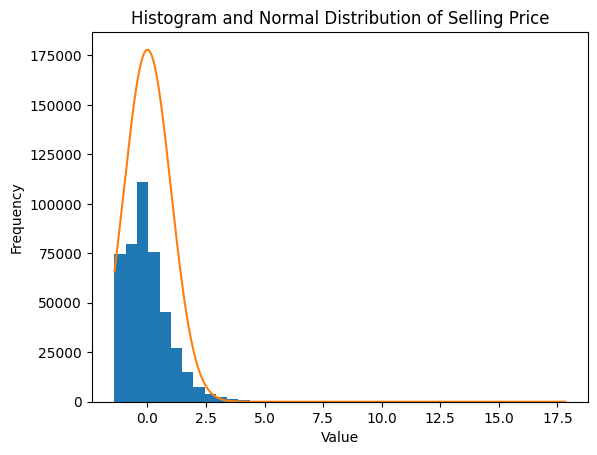

In [ ]:
#plt.hist(df_final['sellingprice'], bins=50, edgecolor='black')
plt.figure(figsize=(15,6))
fig, ax = plt.subplots()
df_final['sellingprice'].plot(kind='hist', ax=ax,bins=40)
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.title('Histogram and Normal Distribution of Selling Price')
#plt.show()

df_mean = np.mean(df_final["sellingprice"])
df_std = np.std(df_final["sellingprice"])

# Calculating probability density function (PDF)
pdf = stats.norm.pdf(df_final["sellingprice"].sort_values(), df_mean, df_std)

# Drawing a normal distribution over
ax.plot(df_final["sellingprice"].sort_values(), pdf * len(df_final["sellingprice"]))

plt.show()

Above denotes the normalized target feature. This ensures that any prior imbalance is rectified. We used log loss normalization

Baseline Model 2 - Linear Regression without Outliers & Standardization (Basic Model)

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
seed = 1234
#removing state, saledate,  'make_vectors', 'model_vectors'  , 'body_vectors' , 'trim_vectors' for non-numerical values
X = df_final[['manufactureyear', 'model', 'transmission', 'condition', 'odometer',
       'exterior', 'interior', 'mmr', 'saleyear',
       'vehicle_age', 'color_duo', 'Acura', 'Aston Martin', 'Audi', 'BMW',
       'Bentley', 'Buick', 'Cadillac', 'Chevrolet', 'Chrysler', 'Daewoo',
       'Dodge', 'FIAT', 'Ferrari', 'Fisker', 'Ford', 'GMC', 'Geo', 'HUMMER',
       'Honda', 'Hyundai', 'Infiniti', 'Isuzu', 'Jaguar', 'Jeep', 'Kia',
       'Lamborghini', 'Land Rover', 'Lexus', 'Lincoln', 'Lotus', 'MINI',
       'Maserati', 'Mazda', 'Mercedes-Benz', 'Mercury', 'Mitsubishi', 'Nissan',
       'Oldsmobile', 'Plymouth', 'Pontiac', 'Porsche', 'Ram', 'Rolls-Royce',
       'Saab', 'Saturn', 'Scion', 'Subaru', 'Suzuki', 'Tesla', 'Toyota',
       'Volkswagen', 'Volvo', 'smart', 'salemonth', 'large', 'medium', 'small',
       'Midwest', 'Northeast', 'South', 'West']]
#X=df_encoded2[['mmr', 'condition']]
y = df_final['sellingprice']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

In [ ]:
# Fit the linear regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error:", mse)
print("Target Variable Selling Price Mean", df_scaled_no_outliers['sellingprice'].mean())
r2 = r2_score(y_test, y_pred)
print("R^2 Score:", r2)

Mean Squared Error: 0.028439831832645052
Target Variable Selling Price Mean 13401.824919971556
R^2 Score: 0.97126992781153


So, removing outliers and standardizing the columns is better since the MSE drastically decreases and R^2 is much higher.

Model 3 - Linear Model with L2 Hyperparameter Tuning

In [ ]:
from sklearn.linear_model import Ridge

seed = 1234
#removing state, saledate,  'make_vectors', 'model_vectors'  , 'body_vectors' , 'trim_vectors' for non-numerical values
X2 = df_final[['manufactureyear', 'model', 'transmission', 'condition', 'odometer',
       'exterior', 'interior', 'mmr', 'saleyear',
       'vehicle_age', 'color_duo', 'Acura', 'Aston Martin', 'Audi', 'BMW',
       'Bentley', 'Buick', 'Cadillac', 'Chevrolet', 'Chrysler', 'Daewoo',
       'Dodge', 'FIAT', 'Ferrari', 'Fisker', 'Ford', 'GMC', 'Geo', 'HUMMER',
       'Honda', 'Hyundai', 'Infiniti', 'Isuzu', 'Jaguar', 'Jeep', 'Kia',
       'Lamborghini', 'Land Rover', 'Lexus', 'Lincoln', 'Lotus', 'MINI',
       'Maserati', 'Mazda', 'Mercedes-Benz', 'Mercury', 'Mitsubishi', 'Nissan',
       'Oldsmobile', 'Plymouth', 'Pontiac', 'Porsche', 'Ram', 'Rolls-Royce',
       'Saab', 'Saturn', 'Scion', 'Subaru', 'Suzuki', 'Tesla', 'Toyota',
       'Volkswagen', 'Volvo', 'smart', 'salemonth', 'large', 'medium', 'small',
       'Midwest', 'Northeast', 'South', 'West']]
#X=df_encoded2[['mmr', 'condition']]
y2 = df_final['sellingprice']
X_train2, X_test2, y_train2, y_test2 = train_test_split(X2, y2, test_size=0.2, random_state=seed)


# Train the Ridge regression model with L2 regularization
alphaStart = 0.1
mseMin = 1000
alphaMin = alphaStart
while(alphaStart < 20):
  ridge = Ridge(alpha=alphaStart)
  ridge.fit(X_train2, y_train2)

# Make predictions on the test set
  y_pred2 = ridge.predict(X_test2)

# Calculate the Mean Squared Error
  mse2 = mean_squared_error(y_test2, y_pred2)
  if(mse2 < mseMin):
      mseMin = mse2
      alphaMin = alphaStart
  alphaStart += 0.2


print("Minimized Mean Squared Error:", mseMin)
print("Alpha for Minimized Mean Squared Error:", alphaMin)
print("Target Variable Selling Price Mean", df_scaled_no_outliers['sellingprice'].mean())
print("R^2 Score:", r2_score(y_test2, y_pred2))

Minimized Mean Squared Error: 0.02843331908759558
Alpha for Minimized Mean Squared Error: 1.6999999999999997
Target Variable Selling Price Mean 13401.824919971556
R^2 Score: 0.9704102558502121


The MSE slightly decreases since this minimizes the MSE with respect to change in alpha. Moreover, R^2 only slightly decreases (by less than 0.01) which indicates that fit is still retained.

## Random Forest Model

Random Forest Model: Here, we develop a baseline Random Forest model and an additional Random Forest model with hyperparameter tuning using RandomizedSearchCV to identify the best performing model and it's associated hyperparameters.

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestRegressor

seed = 1234
X3 = df_final[['manufactureyear', 'model', 'transmission', 'condition', 'odometer',
       'exterior', 'interior', 'mmr', 'saleyear',
       'vehicle_age', 'color_duo', 'Acura', 'Aston Martin', 'Audi', 'BMW',
       'Bentley', 'Buick', 'Cadillac', 'Chevrolet', 'Chrysler', 'Daewoo',
       'Dodge', 'FIAT', 'Ferrari', 'Fisker', 'Ford', 'GMC', 'Geo', 'HUMMER',
       'Honda', 'Hyundai', 'Infiniti', 'Isuzu', 'Jaguar', 'Jeep', 'Kia',
       'Lamborghini', 'Land Rover', 'Lexus', 'Lincoln', 'Lotus', 'MINI',
       'Maserati', 'Mazda', 'Mercedes-Benz', 'Mercury', 'Mitsubishi', 'Nissan',
       'Oldsmobile', 'Plymouth', 'Pontiac', 'Porsche', 'Ram', 'Rolls-Royce',
       'Saab', 'Saturn', 'Scion', 'Subaru', 'Suzuki', 'Tesla', 'Toyota',
       'Volkswagen', 'Volvo', 'smart', 'salemonth', 'large', 'medium', 'small',
       'Midwest', 'Northeast', 'South', 'West']]
y3 = df_final['sellingprice']

X_train3, X_test3, y_train3, y_test3 = train_test_split(X3, y3, test_size=0.2, random_state=seed)

rf = RandomForestRegressor()

rf.fit(X_train3, y_train3)
y_pred3 = rf.predict(X_test3)

mse = mean_squared_error(y_test3, y_pred3)
print("Mean Squared Error:", mse)

Mean Squared Error Baseline RF: 0.019983743905701113

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.ensemble import RandomForestRegressor

seed = 1234
X3 = df_final[['manufactureyear', 'model', 'transmission', 'condition', 'odometer',
       'exterior', 'interior', 'mmr', 'saleyear',
       'vehicle_age', 'color_duo', 'Acura', 'Aston Martin', 'Audi', 'BMW',
       'Bentley', 'Buick', 'Cadillac', 'Chevrolet', 'Chrysler', 'Daewoo',
       'Dodge', 'FIAT', 'Ferrari', 'Fisker', 'Ford', 'GMC', 'Geo', 'HUMMER',
       'Honda', 'Hyundai', 'Infiniti', 'Isuzu', 'Jaguar', 'Jeep', 'Kia',
       'Lamborghini', 'Land Rover', 'Lexus', 'Lincoln', 'Lotus', 'MINI',
       'Maserati', 'Mazda', 'Mercedes-Benz', 'Mercury', 'Mitsubishi', 'Nissan',
       'Oldsmobile', 'Plymouth', 'Pontiac', 'Porsche', 'Ram', 'Rolls-Royce',
       'Saab', 'Saturn', 'Scion', 'Subaru', 'Suzuki', 'Tesla', 'Toyota',
       'Volkswagen', 'Volvo', 'smart', 'salemonth', 'large', 'medium', 'small',
       'Midwest', 'Northeast', 'South', 'West']]
y3 = df_final['sellingprice']

X_train3, X_test3, y_train3, y_test3 = train_test_split(X3, y3, test_size=0.2, random_state=seed)

rf = RandomForestRegressor()

# Define the hyperparameters grid
param_grid = {
    'max_depth': [5, 10, 15],
    'min_samples_split': [4, 16, 32],
    'max_leaf_nodes': [5, 10, 25]
  }

random_search = RandomizedSearchCV(estimator=rf, param_distributions=param_grid)
random_search.fit(X_train3, y_train3)

best_params = random_search.best_params_
print("Best Parameters:", best_params)

best_rf = random_search.best_estimator_
best_rf.fit(X_train3, y_train3)
y_pred3 = best_rf.predict(X_test3)

mse = mean_squared_error(y_test3, y_pred3)
print("Mean Squared Error:", mse)

Best Parameters: {'min_samples_split': 16, 'max_leaf_nodes': 25, 'max_depth': 5}


NameError: name 'mean_squared_error' is not defined

XGBoost Model without hyperparameter tuning: Performs better than L2 Regression by (0.01 MSE). Need to look into evaluation metrics and tinker with that if possible for linear classification + objective function

In [ ]:
import xgboost as xgb
from sklearn.model_selection import GridSearchCV
from xgboost import XGBRegressor

#X = df_final.drop('sellingprice', axis=1)  # Features
#y = df_final['sellingprice']  # Target variable

# Split the data into training and testing sets
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)


# Instantiate the XGBRegressor
xgb_regressor = XGBRegressor(
    objective='reg:squarederror',  # Specify the regression objective
    n_estimators=100,  # Number of trees to fit
    learning_rate=0.1,  # Learning rate
    max_depth=3,  # Maximum tree depth
    random_state=seed
)

X = df_final.drop('sellingprice', axis=1)  # Features
y = df_final['sellingprice']  # Target variable

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

# Convert the data into DMatrix format
xgb_regressor.fit(X_train, y_train)

# After training, you can use the model to make predictions
y_pred = xgb_regressor.predict(X_test)

# Convert the data into DMatrix format
#dtrain = xgb.DMatrix(X_train, label=y_train)
#dtest = xgb.DMatrix(X_test, label=y_test)

# Define the parameters for the XGBoost model
#params = {
 #   'objective': 'reg:squarederror',  # For linear classification
  #  'eval_metric': 'rmse',  # Evaluation metric
   # 'max_depth': 3  # Maximum depth of the tree
#}

# Train the XGBoost model
# num_round = 100  # Number of boosting rounds
# bst = xgb.train(params, dtrain, num_round)



# # Make predictions on the test data
# y_pred = bst.predict(dtest)

# # Convert the predicted probabilities into binary predictions
# threshold = 0.5  # Adjust the threshold as needed

# # Calculate the accuracy of the model
mse_xgb = mean_squared_error(y_test, y_pred)

In [ ]:
print(f'Mean Squared Error: {mse_xgb}')

Mean Squared Error: 0.02976851498942294


XGBoost without Hyperparameter tuning MSE:  0.02976851498942294

XGBoost with Hyper parameter tuning

In [ ]:
import xgboost as xgb
from sklearn.metrics import accuracy_score, precision_score, recall_score
from sklearn.model_selection import GridSearchCV
from xgboost import XGBRegressor


# Instantiate the XGBRegressor
xgb_regressor = XGBRegressor(
    objective='reg:squarederror',  # Specify the regression objective
    n_estimators=100,  # Number of trees to fit
    learning_rate=0.1,  # Learning rate
    max_depth=3,  # Maximum tree depth
    random_state=seed
)

X = df_final.drop('sellingprice', axis=1)  # Features
y = df_final['sellingprice']  # Target variable

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

# Convert the data into DMatrix format
xgb_regressor.fit(X_train, y_train)

# After training, you can use the model to make predictions
y_pred = xgb_regressor.predict(X_test)



param_grid = {
    'max_depth': [3, 6, 9],
    'learning_rate': [0.05, 0.1, 0.3],
    'n_estimators': [100, 200, 300]
  }


grid_search = GridSearchCV(estimator=xgb_regressor, param_grid=param_grid)
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
print("Best Parameters:", best_params)

best_xgb = grid_search.best_estimator_
best_xgb.fit(X_train, y_train)
y_predbest = best_xgb.predict(X_test)

# Make predictions on the test data
#y_pred = bst.predict(dtest)

# Convert the predicted probabilities into binary predictions
#threshold = 0.5  # Adjust the threshold as needed

# Calculate the accuracy of the model
mse_xgb = mean_squared_error(y_test, y_predbest)

# Define the hyperparameters grid


Best Parameters: {'learning_rate': 0.1, 'max_depth': 9, 'n_estimators': 300}


Now, we do hyperparameter tuning on the xgboost model: (BELOW IS NOT BEING USED ANYMORE)

In [ ]:
print(mse_xgb)

0.023882342217504165


MSE of XGBoost Hyperparameter tuning: 0.023882342217504165 (took 34 minutes)

In [ ]:
import xgboost as xgb
from sklearn.metrics import accuracy_score, precision_score, recall_score

X = df_final.drop('sellingprice', axis=1)  # Features
y = df_final['sellingprice']  # Target variable

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

# Convert the data into DMatrix format
dtrain = xgb.DMatrix(X_train, label=y_train)
dtest = xgb.DMatrix(X_test, label=y_test)

# Define the parameters for the XGBoost model
params = {
    'objective': 'reg:squarederror',  # For linear classification
    'eval_metric': 'rmse',  # Evaluation metric
    'max_depth': 3  # Maximum depth of the tree
}

# Train the XGBoost model
num_round = 100  # Number of boosting rounds
bst = xgb.train(params, dtrain, num_round)

# Make predictions on the test data
y_pred = bst.predict(dtest)

# Convert the predicted probabilities into binary predictions
threshold = 0.5  # Adjust the threshold as needed

# Calculate the accuracy of the model
mse_xgb = mean_squared_error(y_test, y_pred)

Light GBM Model

In [ ]:
import lightgbm as lgb

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

# Convert the data into LightGBM Dataset format
train_data = lgb.Dataset(X_train, label=y_train)
test_data = lgb.Dataset(X_test, label=y_test)

# Define the parameters for the LightGBM model
params = {
    'objective': 'regression',  # For linear classification
    'metric': 'logloss',  # Evaluation metric
    'max_depth': 3  # Maximum depth of the tree
}

# Train the LightGBM model
num_round = 100  # Number of boosting rounds
bst = lgb.train(params, train_data, num_round, valid_sets=[test_data])

# Make predictions on the test data
y_pred = bst.predict(X_test, num_iteration=bst.best_iteration)


# Calculate the accuracy of the model
mse_lgb = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error Light GBM: {mse_lgb}')

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.022210 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1094
[LightGBM] [Info] Number of data points in the train set: 356623, number of used features: 62
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 0.001126
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

With outliers:

Normal Linear Regression:
*   Mean Squared Error: 659674325142935.8
*   Target Variable Selling Price Mean 1.8104339556472822e-17

Ridge
*   Mean Squared Error: 0.034176066279047214
*   Target Variable Selling Price Mean 1.8104339556472822e-17


Without outliers

Normal Linear Regression:
*   Mean Squared Error: 1.4017777942180796e+16
*   Target Variable Selling Price Mean 2.779398607965546e-17

Ridge
*   Mean Squared Error: 0.034176066279047235
*   Target Variable Selling Price Mean 2.779398607965546e-17

